In [1]:
from IPython.display import clear_output
!pip install tf_explain
clear_output()

In [34]:
# common
import os
import keras
import numpy as np
import pandas as pd
from glob import glob
import tensorflow as tf
import tensorflow.image as tfi

# Data
from keras_preprocessing.image import load_img, img_to_array
from tensorflow.keras.utils import to_categorical

# Data Viz
import matplotlib.pyplot as plt
# Model 
from keras.models import Model
from keras.layers import Layer
from keras.layers import Conv2D
from keras.layers import Dropout
from keras.layers import UpSampling2D
from keras.layers import concatenate
from keras.layers import Add
from keras.layers import Multiply
from keras.layers import Input
from keras.layers import MaxPool2D
from keras.layers import BatchNormalization

# Callbacks 
from keras.callbacks import Callback
from keras.callbacks import EarlyStopping
from keras.callbacks import ModelCheckpoint
from tf_explain.core.grad_cam import GradCAM

# Metrics
from keras.metrics import MeanIoU

In [3]:
def load_image(image, SIZE):
    return np.round(tfi.resize(img_to_array(load_img(image))/255.,(SIZE, SIZE)),4)

def load_images(image_paths, SIZE, mask=False, trim=None):
    if trim is not None:
        image_paths = image_paths[:trim]
    
    if mask:
        images = np.zeros(shape=(len(image_paths), SIZE, SIZE, 1))
    else:
        images = np.zeros(shape=(len(image_paths), SIZE, SIZE, 3))
    
    for i,image in enumerate(image_paths):
        img = load_image(image,SIZE)
        if mask:
            images[i] = img[:,:,:1]
        else:
            images[i] = img
    
    return images

In [4]:
def show_image(image, title=None, cmap=None, alpha=1):
    plt.imshow(image, cmap=cmap, alpha=alpha)
    if title is not None:
        plt.title(title)
    plt.axis('off')

def show_mask(image, mask, cmap=None, alpha=0.4):
    plt.imshow(image)
    plt.imshow(tf.squeeze(mask), cmap=cmap, alpha=alpha)
    plt.axis('off')

In [5]:
SIZE = 256

In [6]:
root_path = '/users/meghabista/Dataset_BUSI_with_GT/'
classes = sorted(os.listdir(root_path))
classes

['.DS_Store', 'benign', 'malignant', 'normal']

In [7]:
single_mask_paths = sorted([sorted(glob(root_path + name + "/*mask.png")) for name in classes])
double_mask_paths = sorted([sorted(glob(root_path + name + "/*mask_1.png")) for name in classes])


In [8]:
image_paths = []
mask_paths = []
for class_path in single_mask_paths:
    for path in class_path:
        img_path = path.replace('_mask','')
        image_paths.append(img_path)
        mask_paths.append(path)

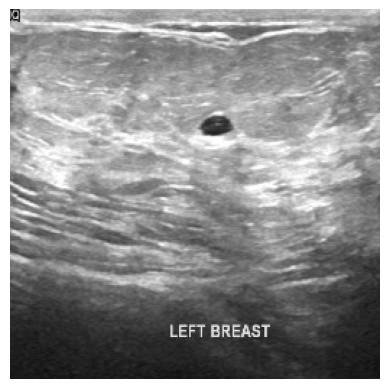

In [29]:
show_image(load_image(image_paths[0], SIZE))

Metal device set to: Apple M1 Pro


2023-05-03 12:18:34.845920: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-05-03 12:18:34.846083: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


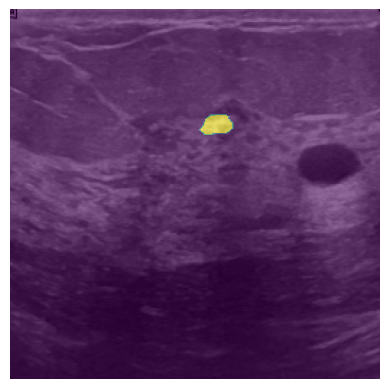

In [9]:
show_mask(load_image(image_paths[3], SIZE), load_image(mask_paths[0], SIZE)[:,:,0], alpha=0.6)

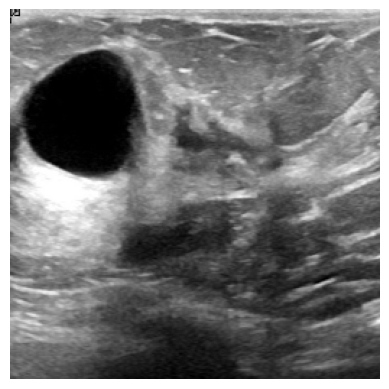

In [10]:
show_image(load_image('/users/meghabista/Dataset_BUSI_with_GT/benign/benign (10).png', SIZE))

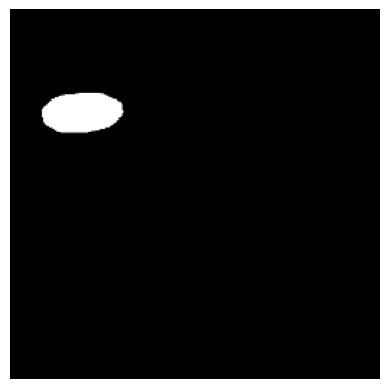

In [11]:
show_image(load_image('/users/meghabista/Dataset_BUSI_with_GT/benign/benign (100)_mask_1.png', SIZE))

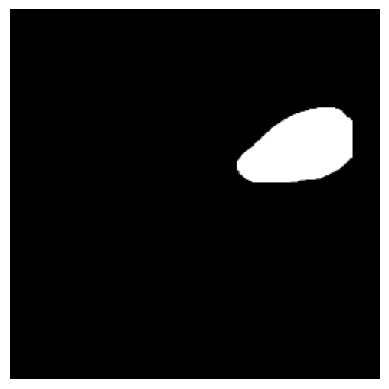

In [12]:
show_image(load_image('/users/meghabista/Dataset_BUSI_with_GT/benign/benign (100)_mask.png', SIZE))

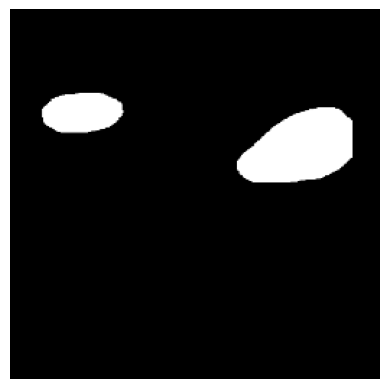

In [13]:
img = np.zeros((1,SIZE,SIZE,3))
mask1 = load_image('/users/meghabista/Dataset_BUSI_with_GT/benign/benign (100)_mask_1.png', SIZE)
mask2 = load_image('/users/meghabista/Dataset_BUSI_with_GT/benign/benign (100)_mask.png', SIZE)

img = img + mask1 + mask2
img = img[0,:,:,0]
show_image(img, cmap='gray')


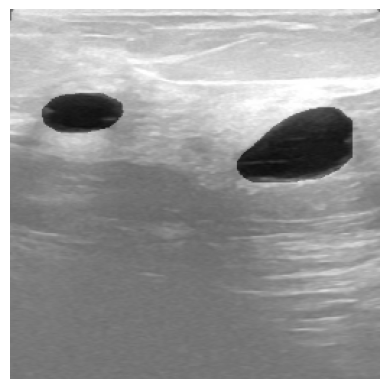

In [14]:
show_image(load_image('/users/meghabista/Dataset_BUSI_with_GT/benign/benign (100).png', SIZE))
plt.imshow(img, cmap='binary', alpha=0.4)
plt.axis('off')
plt.show()

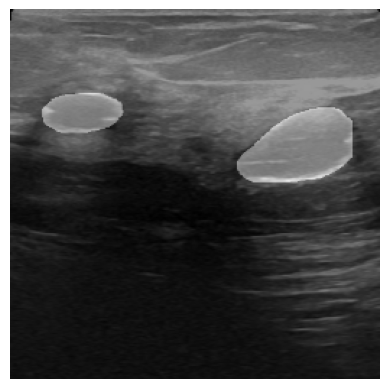

In [15]:
show_image(load_image('/users/meghabista/Dataset_BUSI_with_GT/benign/benign (100).png', SIZE))
plt.imshow(img, cmap='gray', alpha=0.4)
plt.axis('off')
plt.show()

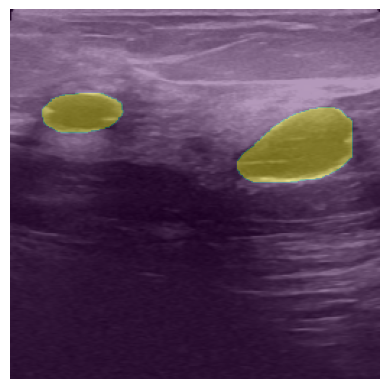

In [16]:
show_image(load_image('/users/meghabista/Dataset_BUSI_with_GT/benign/benign (100).png', SIZE))
plt.imshow(img, alpha=0.4)
plt.axis('off')
plt.show()

This is how it looks with different cmaps. But you can drop them as then are very less in number (i.e 16) and this will not affect training much.

# data

In [17]:
images = load_images(image_paths, SIZE)
masks = load_images(mask_paths, SIZE, mask=True)

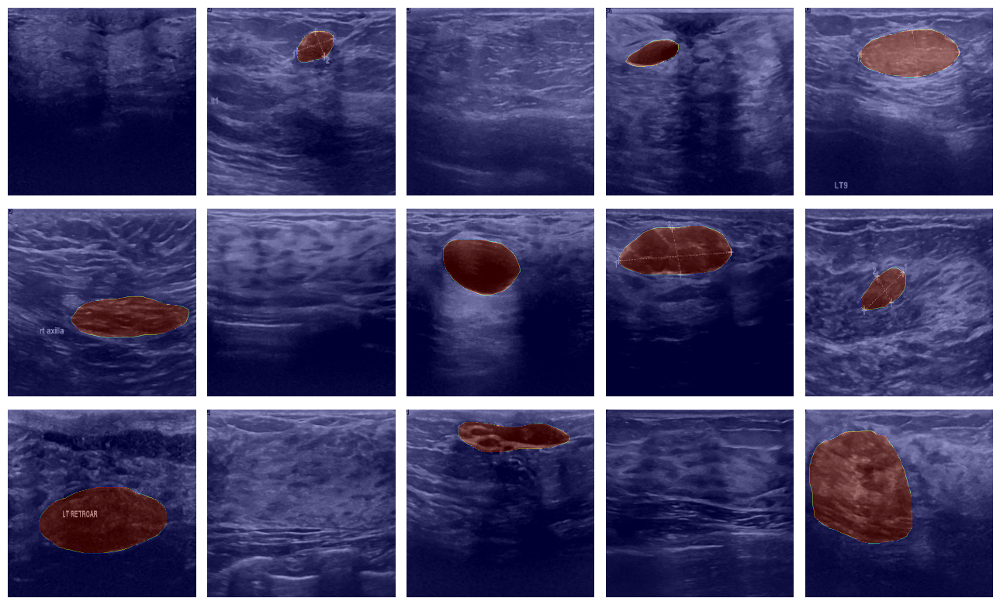

In [18]:

plt.figure(figsize=(13,8))
for i in range(15):
    plt.subplot(3,5,i+1)
    id = np.random.randint(len(images))
    show_mask(images[id], masks[id], cmap='jet')
plt.tight_layout()
plt.show()

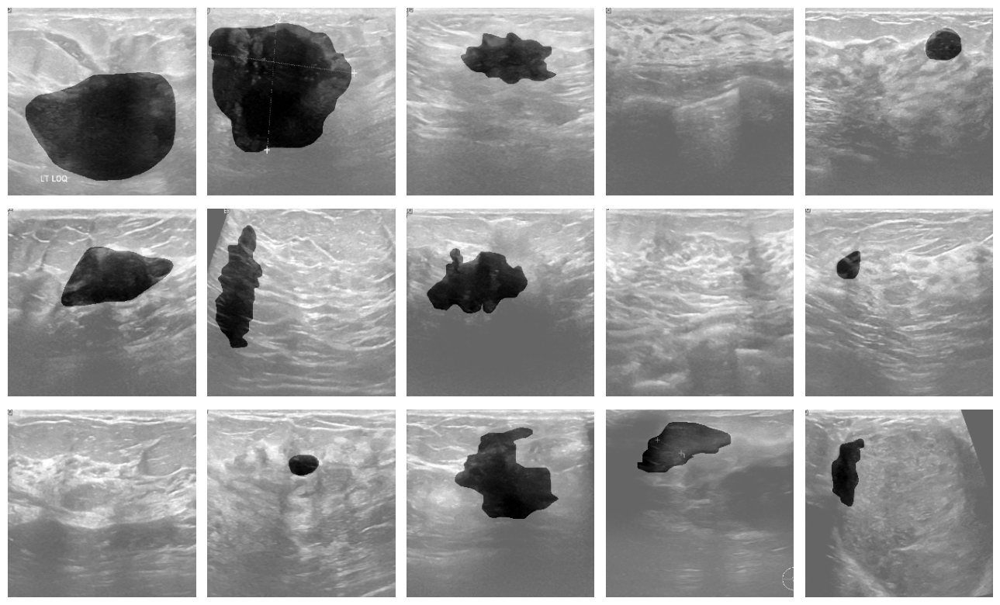

In [19]:
plt.figure(figsize=(13,8))
for i in range(15):
    plt.subplot(3,5,i+1)
    id = np.random.randint(len(images))
    show_mask(images[id], masks[id], cmap='binary')
plt.tight_layout()
plt.show()

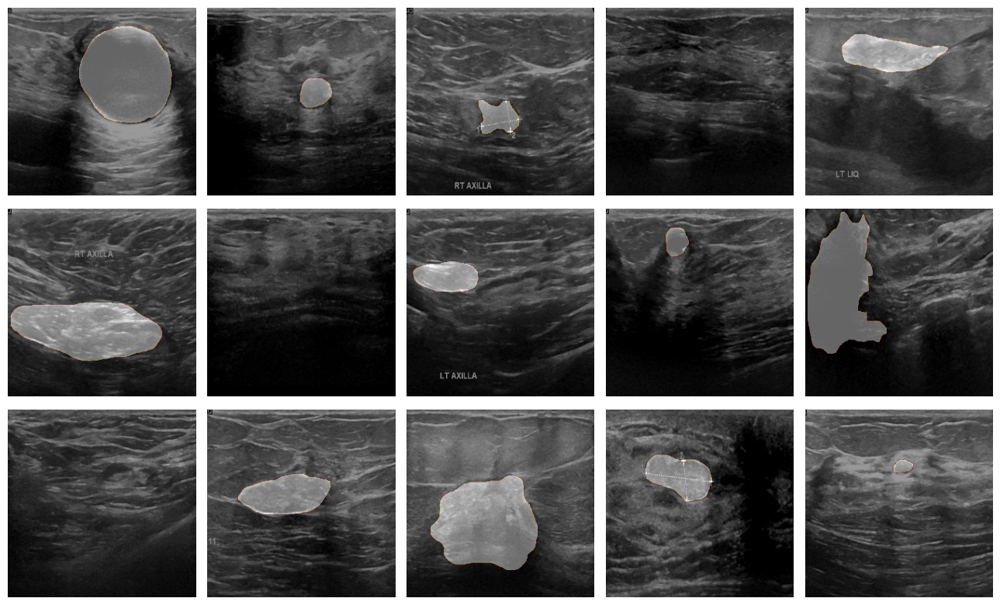

In [20]:
plt.figure(figsize=(13,8))
for i in range(15):
    plt.subplot(3,5,i+1)
    id = np.random.randint(len(images))
    show_mask(images[id], masks[id], cmap='afmhot')
plt.tight_layout()
plt.show()

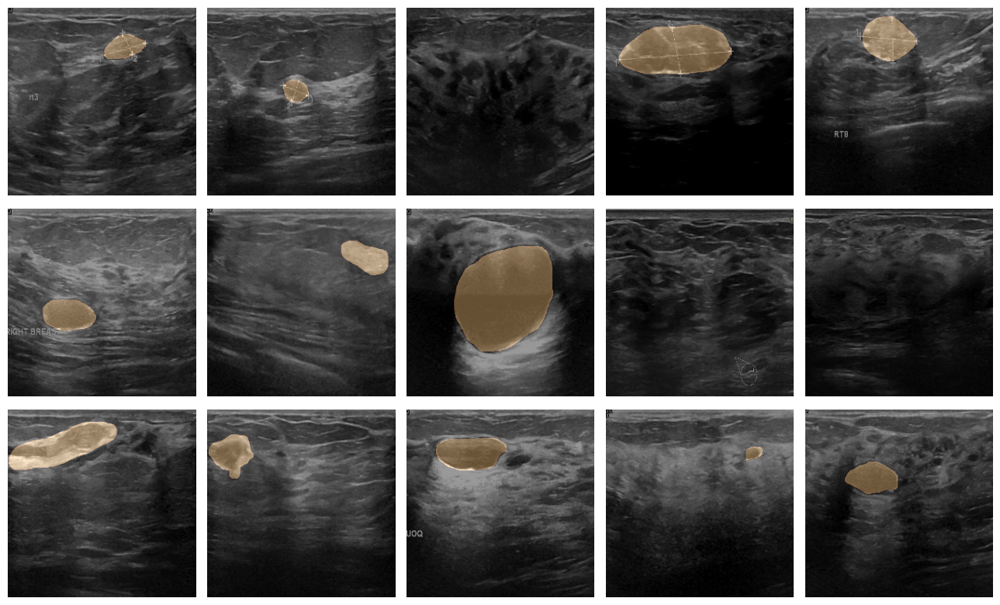

In [21]:
plt.figure(figsize=(13,8))
for i in range(15):
    plt.subplot(3,5,i+1)
    id = np.random.randint(len(images))
    show_mask(images[id], masks[id], cmap='copper')
plt.tight_layout()
plt.show()

In [22]:
class EncoderBlock(Layer):

    def __init__(self, filters, rate, pooling=True, **kwargs):
        super(EncoderBlock, self).__init__(**kwargs)

        self.filters = filters
        self.rate = rate
        self.pooling = pooling

        self.c1 = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.drop = Dropout(rate)
        self.c2 = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.pool = MaxPool2D()

    def call(self, X):
        x = self.c1(X)
        x = self.drop(x)
        x = self.c2(x)
        if self.pooling:
            y = self.pool(x)
            return y, x
        else:
            return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            'rate':self.rate,
            'pooling':self.pooling
        }

Decoder

In [23]:
class DecoderBlock(Layer):

    def __init__(self, filters, rate, **kwargs):
        super(DecoderBlock, self).__init__(**kwargs)

        self.filters = filters
        self.rate = rate

        self.up = UpSampling2D()
        self.net = EncoderBlock(filters, rate, pooling=False)

    def call(self, X):
        X, skip_X = X
        x = self.up(X)
        c_ = concatenate([x, skip_X])
        x = self.net(c_)
        return x
    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            'rate':self.rate,
        }



# Attention Gate

In [24]:
class AttentionGate(Layer):

    def __init__(self, filters, bn, **kwargs):
        super(AttentionGate, self).__init__(**kwargs)

        self.filters = filters
        self.bn = bn

        self.normal = Conv2D(filters, kernel_size=3, padding='same', activation='relu', kernel_initializer='he_normal')
        self.down = Conv2D(filters, kernel_size=3, strides=2, padding='same', activation='relu', kernel_initializer='he_normal')
        self.learn = Conv2D(1, kernel_size=1, padding='same', activation='sigmoid')
        self.resample = UpSampling2D()
        self.BN = BatchNormalization()

    def call(self, X):
        X, skip_X = X
        
        x = self.normal(X)
        skip = self.down(skip_X)
        x = Add()([x, skip])
        x = self.learn(x)
        x = self.resample(x)
        f = Multiply()([x, skip_X])
        if self.bn:
            return self.BN(f)
        else:
            return f
        # return f

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            "bn":self.bn
        }


# Callback 

In [25]:
class ShowProgress(Callback):
    def on_epoch_end(self, epochs, logs=None):
        id = np.random.randint(200)
        exp = GradCAM()
        image = images[id]
        mask = masks[id]
        pred_mask = self.model.predict(image[np.newaxis,...])
        cam = exp.explain(
            validation_data=(image[np.newaxis,...], mask),
            class_index=1,
            layer_name='Attention4',
            model=self.model
        )

        plt.figure(figsize=(10,5))

        plt.subplot(1,3,1)
        plt.title("Original Mask")
        show_mask(image, mask, cmap='copper')

        plt.subplot(1,3,2)
        plt.title("Predicted Mask")
        show_mask(image, pred_mask, cmap='copper')
        
        
        plt.subplot(1,3,3)
        show_image(cam,title="GradCAM")

        plt.tight_layout()
        plt.show()


# Attention Unet

In [26]:
# Inputs
input_layer = Input(shape=images.shape[-3:])

# Encoder
p1, c1 = EncoderBlock(32,0.1, name="Encoder1")(input_layer)
p2, c2 = EncoderBlock(64,0.1, name="Encoder2")(p1)
p3, c3 = EncoderBlock(128,0.2, name="Encoder3")(p2)
p4, c4 = EncoderBlock(256,0.2, name="Encoder4")(p3)


# Encoding
encoding = EncoderBlock(512,0.3, pooling=False, name="Encoding")(p4)


# Attention + Decoder

a1 = AttentionGate(256, bn=True, name="Attention1")([encoding, c4])
d1 = DecoderBlock(256,0.2, name="Decoder1")([encoding, a1])

a2 = AttentionGate(128, bn=True, name="Attention2")([d1, c3])
d2 = DecoderBlock(128,0.2, name="Decoder2")([d1, a2])

a3 = AttentionGate(64, bn=True, name="Attention3")([d2, c2])
d3 = DecoderBlock(64,0.1, name="Decoder3")([d2, a3])


a4 = AttentionGate(32, bn=True, name="Attention4")([d3, c1])
d4 = DecoderBlock(32,0.1, name="Decoder4")([d3, a4])

# Output 
output_layer = Conv2D(1, kernel_size=1, activation='sigmoid', padding='same')(d4)

# Model
model = Model(
    inputs=[input_layer],
    outputs=[output_layer]
)

# Compile
model.compile(
    loss='binary_crossentropy',
    optimizer='adam',
    metrics=['accuracy', MeanIoU(num_classes=2, name='IoU')]
)

# Callbacks
cb = [
    # EarlyStopping(patience=3, restore_best_weight=True), # With Segmentation I trust on eyes rather than on metrics
    ModelCheckpoint("AttentionCustomUNet.h5", save_best_only=True),
    ShowProgress()
]



# Training

Epoch 1/10


2023-05-03 12:21:35.253212: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-05-03 12:21:36.005941: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


 5/97 [>.............................] - ETA: 5:12 - loss: 1.0828 - accuracy: 0.7720 - IoU: 0.4632

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x4dd15fc00>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


60/97 [=================>............] - ETA: 1:52 - loss: 0.3786 - accuracy: 0.8959 - IoU: 0.4555

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x4dd316bd0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


81/97 [========================>.....] - ETA: 47s - loss: 0.3557 - accuracy: 0.8977 - IoU: 0.4549

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x4dd177e80>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.3432 - accuracy: 0.8982 - IoU: 0.4542

2023-05-03 12:26:29.655321: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x285847b90>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
2023-05-03 12:27:19.211196: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 1s 729ms/step


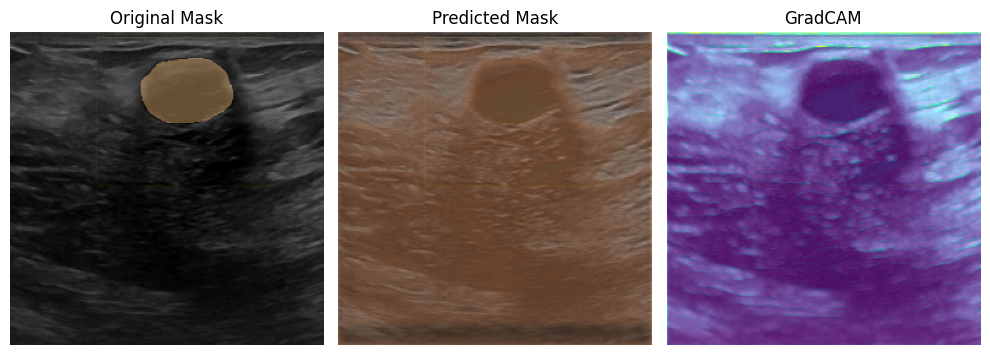

97/97 [==============================] - 347s 4s/step - loss: 0.3432 - accuracy: 0.8982 - IoU: 0.4542 - val_loss: 0.4375 - val_accuracy: 0.9813 - val_IoU: 0.4904
Epoch 2/10
12/97 [==>...........................] - ETA: 3:56 - loss: 0.2598 - accuracy: 0.9002 - IoU: 0.4520

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bfa27ec0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


48/97 [=============>................] - ETA: 2:20 - loss: 0.2370 - accuracy: 0.9105 - IoU: 0.4570

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8593a50>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


52/97 [===============>..............] - ETA: 2:06 - loss: 0.2407 - accuracy: 0.9092 - IoU: 0.4568

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x287256f50>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


63/97 [==================>...........] - ETA: 1:32 - loss: 0.2422 - accuracy: 0.9072 - IoU: 0.4559

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x287256f50>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


71/97 [====================>.........] - ETA: 1:10 - loss: 0.2419 - accuracy: 0.9082 - IoU: 0.4563

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x286a94d10>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


86/97 [=========================>....] - ETA: 29s - loss: 0.2372 - accuracy: 0.9099 - IoU: 0.4569

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2872552a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


88/97 [==========================>...] - ETA: 24s - loss: 0.2373 - accuracy: 0.9091 - IoU: 0.4566    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x286a8b4d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


89/97 [==========================>...] - ETA: 21s - loss: 0.2378 - accuracy: 0.9090 - IoU: 0.4566

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x281cd8290>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


90/97 [==========================>...] - ETA: 18s - loss: 0.2375 - accuracy: 0.9092 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3c03a4570>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


91/97 [===========================>..] - ETA: 15s - loss: 0.2393 - accuracy: 0.9084 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8586280>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


92/97 [===========================>..] - ETA: 13s - loss: 0.2401 - accuracy: 0.9080 - IoU: 0.4566    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2872552a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


93/97 [===========================>..] - ETA: 10s - loss: 0.2394 - accuracy: 0.9084 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x281cde9b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


94/97 [============================>.] - ETA: 7s - loss: 0.2391 - accuracy: 0.9087 - IoU: 0.0000e+00 

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2872552a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


95/97 [============================>.] - ETA: 5s - loss: 0.2401 - accuracy: 0.9082 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2872552a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


96/97 [============================>.] - ETA: 2s - loss: 0.2398 - accuracy: 0.9085 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x286a72850>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.2394 - accuracy: 0.9087 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x281cdd120>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2872552a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 56ms/step


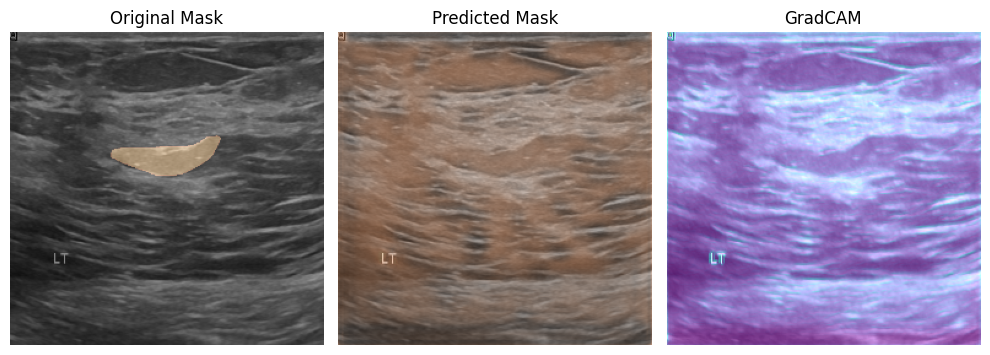

97/97 [==============================] - 287s 3s/step - loss: 0.2394 - accuracy: 0.9087 - IoU: 0.0000e+00 - val_loss: 0.3521 - val_accuracy: 0.9813 - val_IoU: 1.0000
Epoch 3/10


Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b85ae7a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 5/97 [>.............................] - ETA: 3:46 - loss: 0.2374 - accuracy: 0.8975 - IoU: 0.4468

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3c03f5a50>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


11/97 [==>...........................] - ETA: 3:15 - loss: 0.2421 - accuracy: 0.9010 - IoU: 0.4513

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b85759d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


12/97 [==>...........................] - ETA: 3:12 - loss: 0.2359 - accuracy: 0.9044 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3c03fb450>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


13/97 [===>..........................] - ETA: 3:00 - loss: 0.2291 - accuracy: 0.9080 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3c03fb450>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


34/97 [=========>....................] - ETA: 2:35 - loss: 0.2254 - accuracy: 0.9119 - IoU: 0.4521

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b85ad2f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


35/97 [=========>....................] - ETA: 2:31 - loss: 0.2234 - accuracy: 0.9134 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bfac0240>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


39/97 [===========>..................] - ETA: 2:20 - loss: 0.2163 - accuracy: 0.9166 - IoU: 0.4537

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3c03f1f70>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


75/97 [======================>.......] - ETA: 55s - loss: 0.2110 - accuracy: 0.9200 - IoU: 0.4544

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28594dee0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


76/97 [======================>.......] - ETA: 52s - loss: 0.2136 - accuracy: 0.9191 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8621220>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


77/97 [======================>.......] - ETA: 50s - loss: 0.2133 - accuracy: 0.9190 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b86259b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


78/97 [=======================>......] - ETA: 47s - loss: 0.2124 - accuracy: 0.9193 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8621220>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


79/97 [=======================>......] - ETA: 44s - loss: 0.2121 - accuracy: 0.9196 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b86333b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


80/97 [=======================>......] - ETA: 41s - loss: 0.2120 - accuracy: 0.9197 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b85c5660>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


81/97 [========================>.....] - ETA: 38s - loss: 0.2129 - accuracy: 0.9194 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8626490>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


82/97 [========================>.....] - ETA: 36s - loss: 0.2129 - accuracy: 0.9193 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8628e70>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


87/97 [=========================>....] - ETA: 24s - loss: 0.2131 - accuracy: 0.9188 - IoU: 0.4544 

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b862c0e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.2142 - accuracy: 0.9183 - IoU: 0.4546

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bfac6380>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8625f10>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 40ms/step


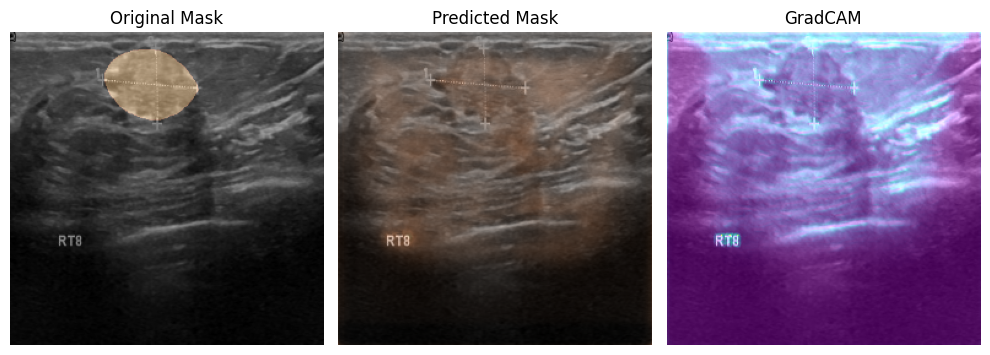

97/97 [==============================] - 277s 3s/step - loss: 0.2142 - accuracy: 0.9183 - IoU: 0.4546 - val_loss: 0.1617 - val_accuracy: 0.9811 - val_IoU: 0.4874
Epoch 4/10
 2/97 [..............................] - ETA: 4:38 - loss: 0.2112 - accuracy: 0.9076 - IoU: 0.4576

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x286a743a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 3/97 [..............................] - ETA: 4:10 - loss: 0.1983 - accuracy: 0.9215 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a36e98e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 4/97 [>.............................] - ETA: 3:03 - loss: 0.1959 - accuracy: 0.9200 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x114e3b900>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 5/97 [>.............................] - ETA: 3:04 - loss: 0.1774 - accuracy: 0.9297 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b85914c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 6/97 [>.............................] - ETA: 3:00 - loss: 0.1964 - accuracy: 0.9274 - IoU: 0.4607    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bfaee5e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 9/97 [=>............................] - ETA: 3:05 - loss: 0.2298 - accuracy: 0.9141 - IoU: 0.4480  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a36e98e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


10/97 [==>...........................] - ETA: 3:04 - loss: 0.2257 - accuracy: 0.9164 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x286a78140>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


14/97 [===>..........................] - ETA: 3:06 - loss: 0.2416 - accuracy: 0.9104 - IoU: 0.4480

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x110760910>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


18/97 [====>.........................] - ETA: 2:58 - loss: 0.2300 - accuracy: 0.9143 - IoU: 0.4523

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a368e9f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


19/97 [====>.........................] - ETA: 2:50 - loss: 0.2272 - accuracy: 0.9151 - IoU: 0.4526

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x283a326d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


21/97 [=====>........................] - ETA: 2:42 - loss: 0.2289 - accuracy: 0.9136 - IoU: 0.4526    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x114e377c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


22/97 [=====>........................] - ETA: 2:38 - loss: 0.2228 - accuracy: 0.9160 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x114e393c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


24/97 [======>.......................] - ETA: 2:39 - loss: 0.2188 - accuracy: 0.9173 - IoU: 0.4527    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a36e98e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


25/97 [======>.......................] - ETA: 2:34 - loss: 0.2191 - accuracy: 0.9174 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x114e3bf80>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


26/97 [=======>......................] - ETA: 2:33 - loss: 0.2162 - accuracy: 0.9186 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x283a18a60>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


27/97 [=======>......................] - ETA: 2:32 - loss: 0.2154 - accuracy: 0.9190 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x283a403e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


29/97 [=======>......................] - ETA: 2:29 - loss: 0.2117 - accuracy: 0.9201 - IoU: 0.4538  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a36e98e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


30/97 [========>.....................] - ETA: 2:27 - loss: 0.2119 - accuracy: 0.9200 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a36e98e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


34/97 [=========>....................] - ETA: 2:19 - loss: 0.2092 - accuracy: 0.9203 - IoU: 0.4530

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a36e98e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


39/97 [===========>..................] - ETA: 2:09 - loss: 0.2105 - accuracy: 0.9202 - IoU: 0.4542

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x4dd21f480>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


49/97 [==============>...............] - ETA: 1:50 - loss: 0.2085 - accuracy: 0.9212 - IoU: 0.4530

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x114e36bb0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


81/97 [========================>.....] - ETA: 39s - loss: 0.2079 - accuracy: 0.9204 - IoU: 0.4540

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8579fe0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


84/97 [========================>.....] - ETA: 32s - loss: 0.2081 - accuracy: 0.9197 - IoU: 0.4536   

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x286ac1f20>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


91/97 [===========================>..] - ETA: 14s - loss: 0.2099 - accuracy: 0.9197 - IoU: 0.4535

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8649f90>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


92/97 [===========================>..] - ETA: 12s - loss: 0.2101 - accuracy: 0.9196 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bfa48940>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


93/97 [===========================>..] - ETA: 9s - loss: 0.2093 - accuracy: 0.9200 - IoU: 0.0000e+00 

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x286ac1240>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.2083 - accuracy: 0.9207 - IoU: 0.4541

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x286aafdd0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b85be6d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 51ms/step


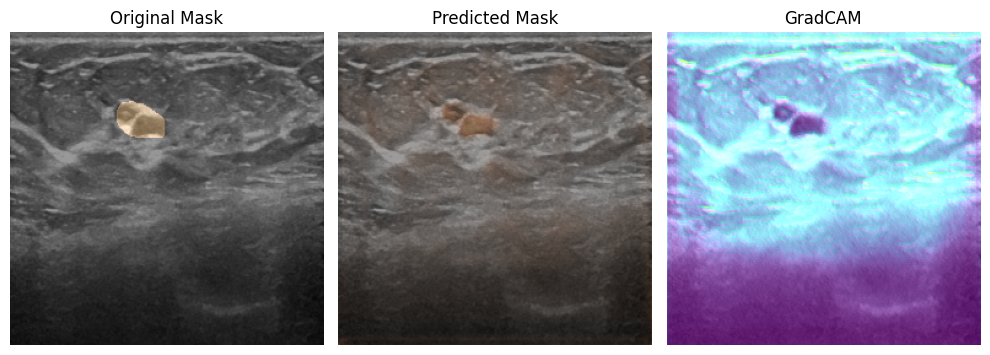

97/97 [==============================] - 273s 3s/step - loss: 0.2083 - accuracy: 0.9207 - IoU: 0.4541 - val_loss: 0.1324 - val_accuracy: 0.9816 - val_IoU: 0.4858
Epoch 5/10
15/97 [===>..........................] - ETA: 3:38 - loss: 0.2123 - accuracy: 0.9205 - IoU: 0.4530

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x283a6fe80>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


22/97 [=====>........................] - ETA: 3:17 - loss: 0.2009 - accuracy: 0.9258 - IoU: 0.4556

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b86631c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


27/97 [=======>......................] - ETA: 3:03 - loss: 0.1996 - accuracy: 0.9260 - IoU: 0.4553

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8662cb0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


41/97 [===========>..................] - ETA: 2:25 - loss: 0.2042 - accuracy: 0.9240 - IoU: 0.4533

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x281cf99b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


49/97 [==============>...............] - ETA: 2:06 - loss: 0.1997 - accuracy: 0.9263 - IoU: 0.4548

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8651020>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


57/97 [================>.............] - ETA: 1:44 - loss: 0.2005 - accuracy: 0.9251 - IoU: 0.4542

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8650050>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


63/97 [==================>...........] - ETA: 1:28 - loss: 0.1979 - accuracy: 0.9261 - IoU: 0.4546

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x281cf4540>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


82/97 [========================>.....] - ETA: 38s - loss: 0.1944 - accuracy: 0.9272 - IoU: 0.4555

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b86504f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


83/97 [========================>.....] - ETA: 35s - loss: 0.1958 - accuracy: 0.9268 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a6f45e30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


90/97 [==========================>...] - ETA: 18s - loss: 0.1961 - accuracy: 0.9271 - IoU: 0.4558

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x283aa66b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


92/97 [===========================>..] - ETA: 12s - loss: 0.1968 - accuracy: 0.9269 - IoU: 0.4559    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a6f45e30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


93/97 [===========================>..] - ETA: 10s - loss: 0.1970 - accuracy: 0.9267 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a6f45e30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


95/97 [============================>.] - ETA: 5s - loss: 0.1978 - accuracy: 0.9260 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a6f45e30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b86575d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

96/97 [============================>.] - ETA: 2s - loss: 0.1977 - accuracy: 0.9260 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x283a53990>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.1973 - accuracy: 0.9263 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x39fd845a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b86724d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 53ms/step


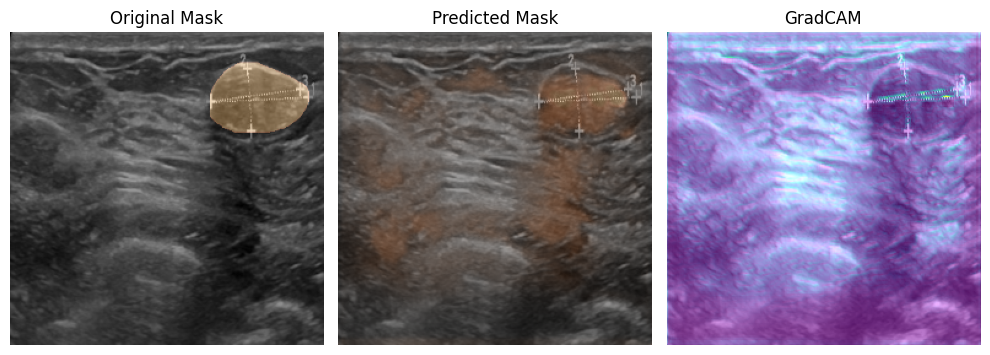

97/97 [==============================] - 287s 3s/step - loss: 0.1973 - accuracy: 0.9263 - IoU: 0.0000e+00 - val_loss: 0.2061 - val_accuracy: 0.9260 - val_IoU: 0.4929
Epoch 6/10
26/97 [=======>......................] - ETA: 3:05 - loss: 0.2048 - accuracy: 0.9235 - IoU: 0.4537

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf40a4a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


38/97 [==========>...................] - ETA: 2:29 - loss: 0.2046 - accuracy: 0.9236 - IoU: 0.4553

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a0995e30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


44/97 [============>.................] - ETA: 2:14 - loss: 0.1939 - accuracy: 0.9279 - IoU: 0.4574

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a098a930>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


47/97 [=============>................] - ETA: 2:05 - loss: 0.1904 - accuracy: 0.9292 - IoU: 0.4582  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a0997d80>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


50/97 [==============>...............] - ETA: 1:57 - loss: 0.2031 - accuracy: 0.9270 - IoU: 0.4582  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8697040>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


51/97 [==============>...............] - ETA: 1:54 - loss: 0.2037 - accuracy: 0.9268 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8697040>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


55/97 [================>.............] - ETA: 1:44 - loss: 0.2065 - accuracy: 0.9259 - IoU: 0.4580

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8697a90>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


57/97 [================>.............] - ETA: 1:39 - loss: 0.2057 - accuracy: 0.9265 - IoU: 0.4581    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x286ad6050>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


58/97 [================>.............] - ETA: 1:36 - loss: 0.2071 - accuracy: 0.9256 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf40ef50>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


68/97 [====================>.........] - ETA: 1:11 - loss: 0.2027 - accuracy: 0.9280 - IoU: 0.4584

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x283a4e240>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


69/97 [====================>.........] - ETA: 1:09 - loss: 0.2022 - accuracy: 0.9281 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8695760>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


70/97 [====================>.........] - ETA: 1:06 - loss: 0.2043 - accuracy: 0.9271 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8676f80>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


74/97 [=====================>........] - ETA: 56s - loss: 0.2011 - accuracy: 0.9283 - IoU: 0.4594  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x286af84f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


78/97 [=======================>......] - ETA: 46s - loss: 0.2008 - accuracy: 0.9284 - IoU: 0.4594  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b85f2540>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.1977 - accuracy: 0.9284 - IoU: 0.4585

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf719de0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


1/1 [==============================] - 0s 50ms/step


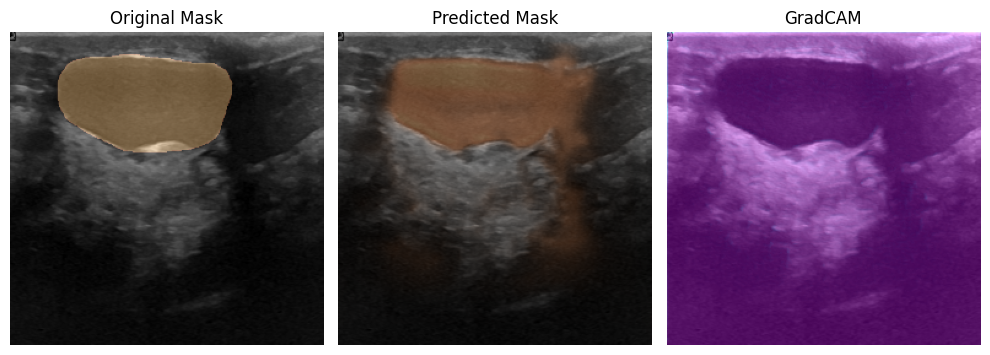

97/97 [==============================] - 281s 3s/step - loss: 0.1977 - accuracy: 0.9284 - IoU: 0.4585 - val_loss: 0.0918 - val_accuracy: 0.9808 - val_IoU: 0.4904
Epoch 7/10


Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b865a840>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


31/97 [========>.....................] - ETA: 3:38 - loss: 0.1873 - accuracy: 0.9282 - IoU: 0.4590

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b86a46a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


73/97 [=====================>........] - ETA: 1:16 - loss: 0.1938 - accuracy: 0.9264 - IoU: 0.4546

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf781e30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


74/97 [=====================>........] - ETA: 1:12 - loss: 0.1949 - accuracy: 0.9260 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf434b20>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


77/97 [======================>.......] - ETA: 1:02 - loss: 0.1946 - accuracy: 0.9261 - IoU: 0.4546  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x286ae1db0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


78/97 [=======================>......] - ETA: 58s - loss: 0.1937 - accuracy: 0.9266 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8683f00>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


80/97 [=======================>......] - ETA: 52s - loss: 0.1929 - accuracy: 0.9270 - IoU: 0.4546    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf788d90>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


81/97 [========================>.....] - ETA: 48s - loss: 0.1929 - accuracy: 0.9269 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b869daf0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


82/97 [========================>.....] - ETA: 45s - loss: 0.1929 - accuracy: 0.9269 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8683f00>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


83/97 [========================>.....] - ETA: 41s - loss: 0.1930 - accuracy: 0.9268 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf727f30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.1897 - accuracy: 0.9280 - IoU: 0.4550

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7896e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf43d2d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 44ms/step


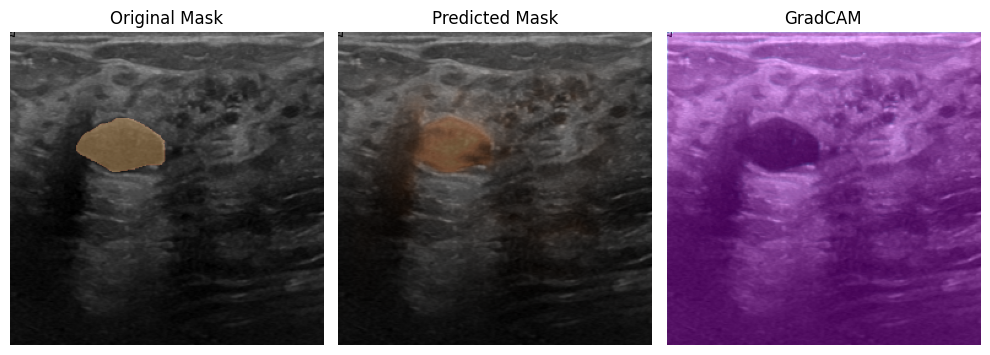

97/97 [==============================] - 332s 3s/step - loss: 0.1897 - accuracy: 0.9280 - IoU: 0.4550 - val_loss: 0.0709 - val_accuracy: 0.9818 - val_IoU: 0.4929
Epoch 8/10


Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7bf8e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


16/97 [===>..........................] - ETA: 3:40 - loss: 0.1749 - accuracy: 0.9319 - IoU: 0.4571

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x286ae0a70>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


27/97 [=======>......................] - ETA: 3:15 - loss: 0.1787 - accuracy: 0.9316 - IoU: 0.4563

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b86a5220>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


56/97 [================>.............] - ETA: 1:41 - loss: 0.1924 - accuracy: 0.9271 - IoU: 0.4540

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7cc6b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


57/97 [================>.............] - ETA: 1:38 - loss: 0.1926 - accuracy: 0.9270 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b86dd440>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


58/97 [================>.............] - ETA: 1:35 - loss: 0.1906 - accuracy: 0.9279 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b86dd440>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


62/97 [==================>...........] - ETA: 1:26 - loss: 0.1884 - accuracy: 0.9287 - IoU: 0.4539

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7ee1a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


1/1 [==============================] - 0s 61ms/steploss: 0.1789 - accuracy: 0.9328 - IoU: 0.45


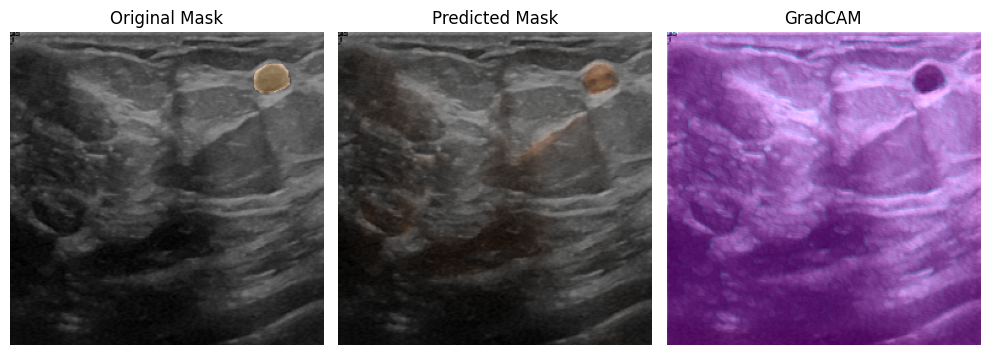

97/97 [==============================] - 332s 3s/step - loss: 0.1789 - accuracy: 0.9328 - IoU: 0.4553 - val_loss: 0.0700 - val_accuracy: 0.9839 - val_IoU: 0.4909
Epoch 9/10
1/1 [==============================] - 0s 43ms/step


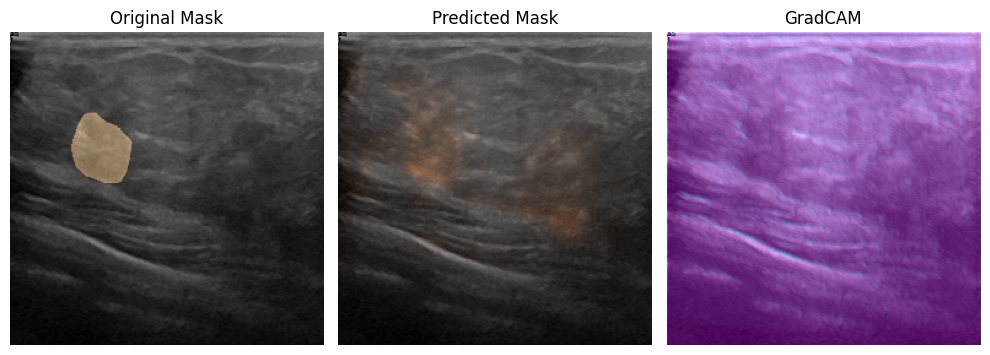

97/97 [==============================] - 79s 784ms/step - loss: 0.1514 - accuracy: 0.9466 - IoU: 0.4682 - val_loss: 0.0652 - val_accuracy: 0.9840 - val_IoU: 0.4909


In [27]:
# Config Training
BATCH_SIZE = 8
SPE = len(images)//BATCH_SIZE

# Training
results = model.fit(
    images, masks,
    validation_split=0.2,
    epochs=10, 
    steps_per_epoch=SPE,
    batch_size=BATCH_SIZE,
    callbacks=cb
)

Epoch 1/20
28/97 [=======>......................] - ETA: 3:45 - loss: 0.1719 - accuracy: 0.9360 - IoU: 0.4568

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf4b55d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


1/1 [==============================] - 0s 34ms/steploss: 0.1785 - accuracy: 0.9348 - IoU: 0.45


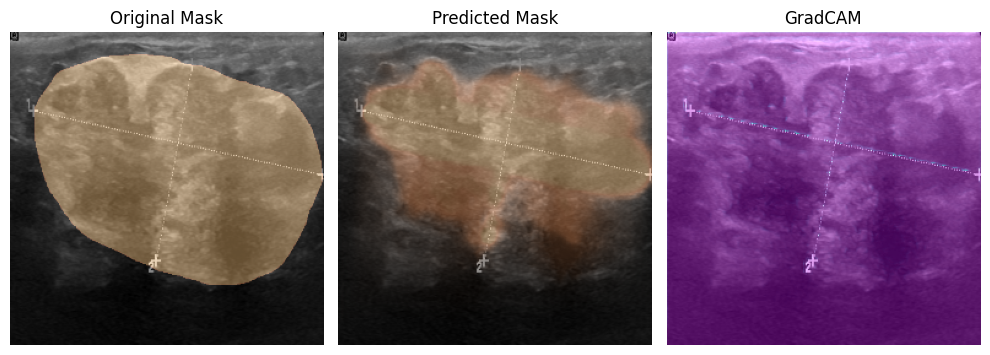

97/97 [==============================] - 352s 4s/step - loss: 0.1785 - accuracy: 0.9348 - IoU: 0.4557 - val_loss: 0.0930 - val_accuracy: 0.9837 - val_IoU: 0.4909
Epoch 2/20
36/97 [==========>...................] - ETA: 3:25 - loss: 0.1666 - accuracy: 0.9371 - IoU: 0.4570

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80b1720>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


42/97 [===========>..................] - ETA: 2:59 - loss: 0.1641 - accuracy: 0.9382 - IoU: 0.4567

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf4ac3b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


43/97 [============>.................] - ETA: 2:53 - loss: 0.1643 - accuracy: 0.9386 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8097500>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


48/97 [=============>................] - ETA: 2:33 - loss: 0.1644 - accuracy: 0.9384 - IoU: 0.4572

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x285987280>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


49/97 [==============>...............] - ETA: 2:28 - loss: 0.1636 - accuracy: 0.9386 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87533e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


55/97 [================>.............] - ETA: 2:06 - loss: 0.1606 - accuracy: 0.9394 - IoU: 0.4571

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b875cde0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.1599 - accuracy: 0.9405 - IoU: 0.4549

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b873e8e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8750140>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 64ms/step


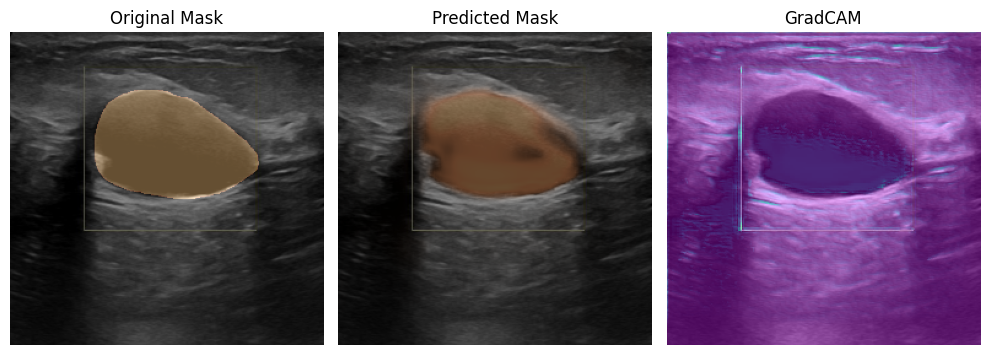

97/97 [==============================] - 360s 4s/step - loss: 0.1599 - accuracy: 0.9405 - IoU: 0.4549 - val_loss: 0.0637 - val_accuracy: 0.9846 - val_IoU: 0.4899
Epoch 3/20
 1/97 [..............................] - ETA: 5:34 - loss: 0.1547 - accuracy: 0.9412 - IoU: 0.4476

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80c09b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 8/97 [=>............................] - ETA: 3:46 - loss: 0.1353 - accuracy: 0.9481 - IoU: 0.4650

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b817a7a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


21/97 [=====>........................] - ETA: 3:06 - loss: 0.1619 - accuracy: 0.9416 - IoU: 0.4593

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87796f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


23/97 [======>.......................] - ETA: 3:01 - loss: 0.1648 - accuracy: 0.9401 - IoU: 0.4585

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b877aac0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


24/97 [======>.......................] - ETA: 2:57 - loss: 0.1640 - accuracy: 0.9409 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87856a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


26/97 [=======>......................] - ETA: 2:52 - loss: 0.1604 - accuracy: 0.9430 - IoU: 0.4592    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80e58c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


28/97 [=======>......................] - ETA: 2:46 - loss: 0.1637 - accuracy: 0.9422 - IoU: 0.4602    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8779850>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


31/97 [========>.....................] - ETA: 2:38 - loss: 0.1657 - accuracy: 0.9407 - IoU: 0.4588  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x11061b0a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


32/97 [========>.....................] - ETA: 2:34 - loss: 0.1654 - accuracy: 0.9406 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80ebef0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


34/97 [=========>....................] - ETA: 2:26 - loss: 0.1644 - accuracy: 0.9403 - IoU: 0.4588    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87796f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


38/97 [==========>...................] - ETA: 2:18 - loss: 0.1664 - accuracy: 0.9392 - IoU: 0.4594

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8787090>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


39/97 [===========>..................] - ETA: 2:16 - loss: 0.1653 - accuracy: 0.9397 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80ecde0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


40/97 [===========>..................] - ETA: 2:11 - loss: 0.1632 - accuracy: 0.9405 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8186330>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


44/97 [============>.................] - ETA: 2:02 - loss: 0.1667 - accuracy: 0.9385 - IoU: 0.4566

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80ca940>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


45/97 [============>.................] - ETA: 1:59 - loss: 0.1660 - accuracy: 0.9387 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80d8490>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


46/97 [=============>................] - ETA: 1:55 - loss: 0.1658 - accuracy: 0.9387 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81a0120>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


49/97 [==============>...............] - ETA: 1:48 - loss: 0.1709 - accuracy: 0.9368 - IoU: 0.4553  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80e3930>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


50/97 [==============>...............] - ETA: 1:45 - loss: 0.1716 - accuracy: 0.9367 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b819ef20>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


52/97 [===============>..............] - ETA: 1:40 - loss: 0.1713 - accuracy: 0.9370 - IoU: 0.4555    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87786c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


53/97 [===============>..............] - ETA: 1:37 - loss: 0.1706 - accuracy: 0.9374 - IoU: 0.0018

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8778ff0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


57/97 [================>.............] - ETA: 1:29 - loss: 0.1721 - accuracy: 0.9366 - IoU: 0.4545

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8791ab0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


61/97 [=================>............] - ETA: 1:22 - loss: 0.1725 - accuracy: 0.9361 - IoU: 0.4537

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80fb520>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


63/97 [==================>...........] - ETA: 1:17 - loss: 0.1709 - accuracy: 0.9367 - IoU: 0.4542    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81a1ae0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


64/97 [==================>...........] - ETA: 1:15 - loss: 0.1716 - accuracy: 0.9364 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b879cf30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


68/97 [====================>.........] - ETA: 1:06 - loss: 0.1766 - accuracy: 0.9329 - IoU: 0.4548

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf4ef870>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


69/97 [====================>.........] - ETA: 1:03 - loss: 0.1807 - accuracy: 0.9296 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b818dae0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


72/97 [=====================>........] - ETA: 56s - loss: 0.1852 - accuracy: 0.9296 - IoU: 0.4553    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87909e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


78/97 [=======================>......] - ETA: 43s - loss: 0.1940 - accuracy: 0.9280 - IoU: 0.4551

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf4eb4e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


82/97 [========================>.....] - ETA: 34s - loss: 0.2017 - accuracy: 0.9258 - IoU: 0.4543  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81827a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


83/97 [========================>.....] - ETA: 32s - loss: 0.2025 - accuracy: 0.9259 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81a2280>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


85/97 [=========================>....] - ETA: 27s - loss: 0.2052 - accuracy: 0.9249 - IoU: 0.4540    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80f21e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


92/97 [===========================>..] - ETA: 11s - loss: 0.2489 - accuracy: 0.9232 - IoU: 0.4540

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b807b220>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


93/97 [===========================>..] - ETA: 9s - loss: 0.2486 - accuracy: 0.9236 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87abd00>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.2556 - accuracy: 0.9225 - IoU: 0.4536

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81a0820>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80c0c70>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 55ms/step


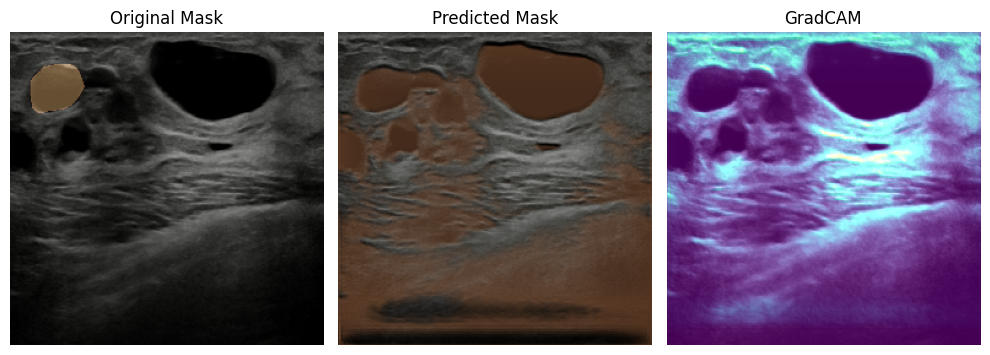

97/97 [==============================] - 272s 3s/step - loss: 0.2556 - accuracy: 0.9225 - IoU: 0.4536 - val_loss: 0.2212 - val_accuracy: 0.9812 - val_IoU: 0.4915
Epoch 4/20
 1/97 [..............................] - ETA: 5:07 - loss: 0.3945 - accuracy: 0.9065 - IoU: 0.4574

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b879fc10>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 2/97 [..............................] - ETA: 1:23 - loss: 0.3537 - accuracy: 0.9148 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81c54d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 4/97 [>.............................] - ETA: 2:33 - loss: 0.4266 - accuracy: 0.9004 - IoU: 0.4619    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b819ef70>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 5/97 [>.............................] - ETA: 2:23 - loss: 0.4075 - accuracy: 0.8984 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80c76e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 6/97 [>.............................] - ETA: 2:33 - loss: 0.3769 - accuracy: 0.9098 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80d48f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 7/97 [=>............................] - ETA: 2:29 - loss: 0.3562 - accuracy: 0.9164 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87a3ca0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


10/97 [==>...........................] - ETA: 2:45 - loss: 0.5021 - accuracy: 0.9076 - IoU: 0.4493  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87aa740>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


12/97 [==>...........................] - ETA: 2:52 - loss: 0.4714 - accuracy: 0.9096 - IoU: 0.4485    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87aa740>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


15/97 [===>..........................] - ETA: 2:56 - loss: 0.4547 - accuracy: 0.9049 - IoU: 0.4446  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80ec310>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


17/97 [====>.........................] - ETA: 2:52 - loss: 0.4334 - accuracy: 0.9081 - IoU: 0.4480    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87a4220>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


18/97 [====>.........................] - ETA: 2:49 - loss: 0.4273 - accuracy: 0.9079 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80f8040>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


22/97 [=====>........................] - ETA: 2:41 - loss: 0.4230 - accuracy: 0.9069 - IoU: 0.4496

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80bd3f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


26/97 [=======>......................] - ETA: 2:33 - loss: 0.4070 - accuracy: 0.9080 - IoU: 0.4525

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81b24a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


33/97 [=========>....................] - ETA: 2:29 - loss: 0.3780 - accuracy: 0.9107 - IoU: 0.4560

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x11061a090>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


36/97 [==========>...................] - ETA: 2:21 - loss: 0.3751 - accuracy: 0.9101 - IoU: 0.4564  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80e1d30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


40/97 [===========>..................] - ETA: 2:14 - loss: 0.3697 - accuracy: 0.9092 - IoU: 0.4566

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80c7e00>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


44/97 [============>.................] - ETA: 2:07 - loss: 0.3686 - accuracy: 0.9071 - IoU: 0.4558

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81c7b40>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


47/97 [=============>................] - ETA: 2:02 - loss: 0.3608 - accuracy: 0.9089 - IoU: 0.4568  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8797900>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


54/97 [===============>..............] - ETA: 1:49 - loss: 0.3584 - accuracy: 0.9098 - IoU: 0.4566

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b878fb70>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


57/97 [================>.............] - ETA: 1:41 - loss: 0.3548 - accuracy: 0.9101 - IoU: 0.4572  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2859af560>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


68/97 [====================>.........] - ETA: 1:15 - loss: 0.3586 - accuracy: 0.9087 - IoU: 0.4561

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80ec700>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


72/97 [=====================>........] - ETA: 1:05 - loss: 0.3575 - accuracy: 0.9076 - IoU: 0.4551

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80ecfb0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


90/97 [==========================>...] - ETA: 18s - loss: 0.3500 - accuracy: 0.9060 - IoU: 0.4538

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81c5d90>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


91/97 [===========================>..] - ETA: 15s - loss: 0.3490 - accuracy: 0.9063 - IoU: 0.4538

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81e2820>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


95/97 [============================>.] - ETA: 5s - loss: 0.3450 - accuracy: 0.9073 - IoU: 0.4544  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81b09b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


96/97 [============================>.] - ETA: 2s - loss: 0.3457 - accuracy: 0.9069 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81db5c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.3444 - accuracy: 0.9073 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf4a1880>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81e7500>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 37ms/step


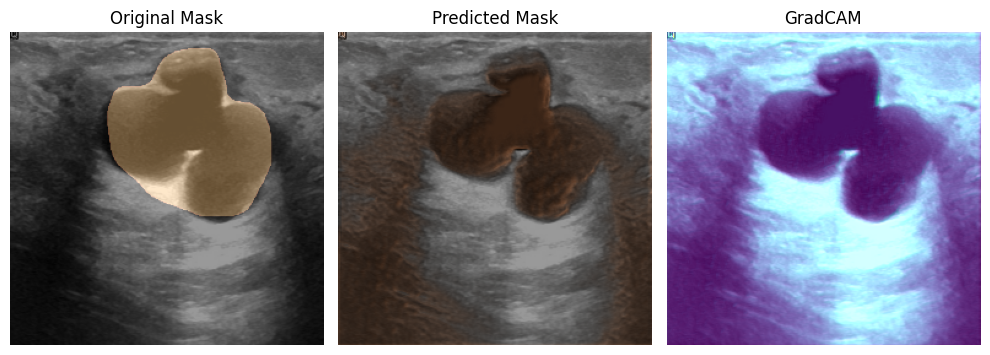

97/97 [==============================] - 289s 3s/step - loss: 0.3444 - accuracy: 0.9073 - IoU: 0.0000e+00 - val_loss: 0.1602 - val_accuracy: 0.9813 - val_IoU: 0.4858
Epoch 5/20


Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x110642ef0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 1/97 [..............................] - ETA: 3:18 - loss: 0.3858 - accuracy: 0.8570 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x110653200>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 4/97 [>.............................] - ETA: 3:57 - loss: 0.3558 - accuracy: 0.8824 - IoU: 0.4554  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf4e9b30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 5/97 [>.............................] - ETA: 3:31 - loss: 0.3649 - accuracy: 0.8777 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81dcb20>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 7/97 [=>............................] - ETA: 3:07 - loss: 0.3382 - accuracy: 0.8894 - IoU: 0.4608    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80f0970>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 8/97 [=>............................] - ETA: 3:01 - loss: 0.3264 - accuracy: 0.8950 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80e7810>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


14/97 [===>..........................] - ETA: 3:10 - loss: 0.3017 - accuracy: 0.9061 - IoU: 0.4633

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x110653e50>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


15/97 [===>..........................] - ETA: 3:05 - loss: 0.2975 - accuracy: 0.9079 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81f0f10>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


24/97 [======>.......................] - ETA: 2:58 - loss: 0.2900 - accuracy: 0.9113 - IoU: 0.4610

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81ca530>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


35/97 [=========>....................] - ETA: 2:34 - loss: 0.2892 - accuracy: 0.9119 - IoU: 0.4603

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80b9c00>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


36/97 [==========>...................] - ETA: 2:29 - loss: 0.2866 - accuracy: 0.9130 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x110667cb0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


45/97 [============>.................] - ETA: 2:09 - loss: 0.2939 - accuracy: 0.9091 - IoU: 0.4574

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf78a660>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


46/97 [=============>................] - ETA: 2:06 - loss: 0.2930 - accuracy: 0.9095 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf78ec30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


56/97 [================>.............] - ETA: 1:44 - loss: 0.2946 - accuracy: 0.9085 - IoU: 0.4563

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x11066a170>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


58/97 [================>.............] - ETA: 1:39 - loss: 0.2928 - accuracy: 0.9091 - IoU: 0.4566    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81f5190>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


60/97 [=================>............] - ETA: 1:33 - loss: 0.2944 - accuracy: 0.9082 - IoU: 0.4565    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81d3910>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


62/97 [==================>...........] - ETA: 1:28 - loss: 0.2945 - accuracy: 0.9080 - IoU: 0.4562    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf78a440>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


69/97 [====================>.........] - ETA: 1:12 - loss: 0.2952 - accuracy: 0.9072 - IoU: 0.4554

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87bc940>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


70/97 [====================>.........] - ETA: 1:09 - loss: 0.2951 - accuracy: 0.9072 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf78b8c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


71/97 [====================>.........] - ETA: 1:07 - loss: 0.2940 - accuracy: 0.9077 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81f63b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


74/97 [=====================>........] - ETA: 58s - loss: 0.2957 - accuracy: 0.9068 - IoU: 0.4548   

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7ea120>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


75/97 [======================>.......] - ETA: 55s - loss: 0.2950 - accuracy: 0.9071 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x11066e150>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


79/97 [=======================>......] - ETA: 45s - loss: 0.2964 - accuracy: 0.9066 - IoU: 0.4542  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x110650970>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


80/97 [=======================>......] - ETA: 43s - loss: 0.2978 - accuracy: 0.9058 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x11065d180>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.2973 - accuracy: 0.9059 - IoU: 0.4542

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81e9720>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7a00c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 60ms/step


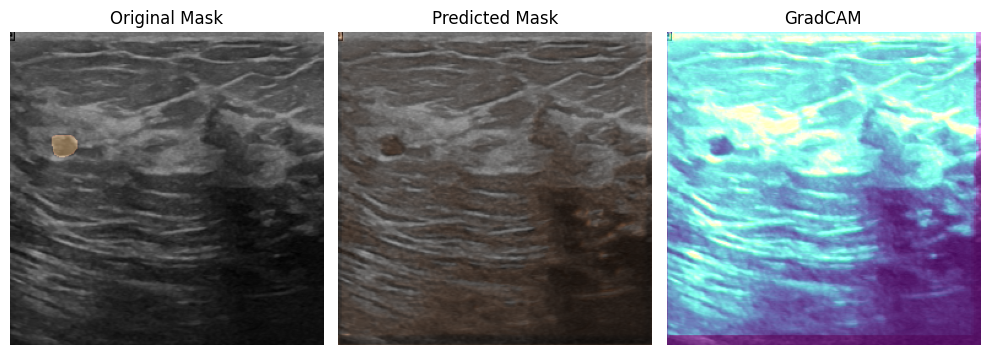

97/97 [==============================] - 303s 3s/step - loss: 0.2973 - accuracy: 0.9059 - IoU: 0.4542 - val_loss: 0.1267 - val_accuracy: 0.9813 - val_IoU: 0.4921
Epoch 6/20


Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x110649590>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 3/97 [..............................] - ETA: 4:39 - loss: 0.2914 - accuracy: 0.9054 - IoU: 0.4416  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b81fa0d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 8/97 [=>............................] - ETA: 4:02 - loss: 0.2879 - accuracy: 0.9060 - IoU: 0.4532

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x110659dd0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


11/97 [==>...........................] - ETA: 3:44 - loss: 0.2783 - accuracy: 0.9115 - IoU: 0.4573  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x1106c10c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


18/97 [====>.........................] - ETA: 3:25 - loss: 0.2809 - accuracy: 0.9115 - IoU: 0.4576

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd04080>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


27/97 [=======>......................] - ETA: 3:13 - loss: 0.2796 - accuracy: 0.9120 - IoU: 0.4571

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x1106c4610>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


28/97 [=======>......................] - ETA: 3:07 - loss: 0.2802 - accuracy: 0.9121 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd0c500>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


29/97 [=======>......................] - ETA: 3:00 - loss: 0.2836 - accuracy: 0.9104 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd092f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


31/97 [========>.....................] - ETA: 2:54 - loss: 0.2893 - accuracy: 0.9081 - IoU: 0.4560    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x1106b12b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


37/97 [==========>...................] - ETA: 2:36 - loss: 0.2847 - accuracy: 0.9102 - IoU: 0.4563

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x1106afbe0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


61/97 [=================>............] - ETA: 1:42 - loss: 0.2909 - accuracy: 0.9074 - IoU: 0.4546

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80e8620>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


96/97 [============================>.] - ETA: 2s - loss: 0.2903 - accuracy: 0.9078 - IoU: 0.4545

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b80b8f10>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.2909 - accuracy: 0.9075 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7dba90>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x1106c3bc0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 58ms/step


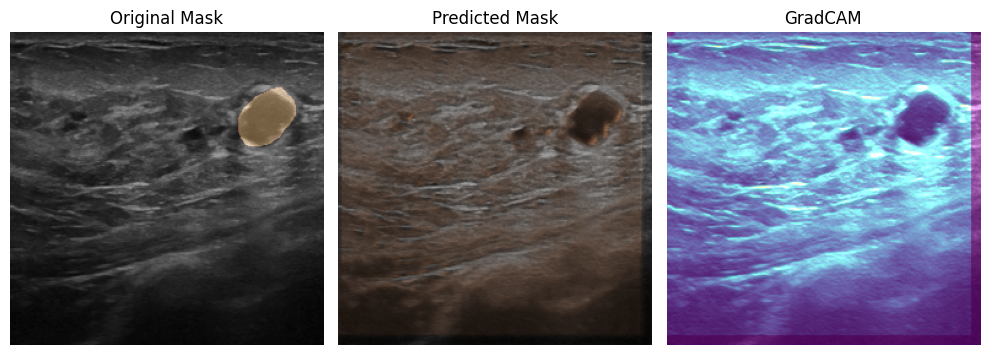

97/97 [==============================] - 313s 3s/step - loss: 0.2909 - accuracy: 0.9075 - IoU: 0.0000e+00 - val_loss: 0.1357 - val_accuracy: 0.9812 - val_IoU: 0.4878
Epoch 7/20


Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87eb260>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 1/97 [..............................] - ETA: 4:17 - loss: 0.2800 - accuracy: 0.9198 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7f2290>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 2/97 [..............................] - ETA: 2:30 - loss: 0.2724 - accuracy: 0.9193 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b21ce60>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 6/97 [>.............................] - ETA: 4:03 - loss: 0.3352 - accuracy: 0.8840 - IoU: 0.4354

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd44b70>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 9/97 [=>............................] - ETA: 3:55 - loss: 0.3093 - accuracy: 0.8982 - IoU: 0.4475  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b20e6e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


10/97 [==>...........................] - ETA: 3:43 - loss: 0.2957 - accuracy: 0.9055 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87e63e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


11/97 [==>...........................] - ETA: 3:43 - loss: 0.2973 - accuracy: 0.9055 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7a11e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


13/97 [===>..........................] - ETA: 3:32 - loss: 0.3106 - accuracy: 0.8999 - IoU: 0.4457    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd3c3a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


14/97 [===>..........................] - ETA: 3:17 - loss: 0.3122 - accuracy: 0.9015 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd18390>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


15/97 [===>..........................] - ETA: 3:11 - loss: 0.3083 - accuracy: 0.9044 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b20f610>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


23/97 [======>.......................] - ETA: 3:04 - loss: 0.3025 - accuracy: 0.9095 - IoU: 0.4532

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd3cd70>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


24/97 [======>.......................] - ETA: 2:58 - loss: 0.3036 - accuracy: 0.9089 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7fe8a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


29/97 [=======>......................] - ETA: 2:47 - loss: 0.3098 - accuracy: 0.9057 - IoU: 0.4514

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd23db0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


30/97 [========>.....................] - ETA: 2:41 - loss: 0.3056 - accuracy: 0.9073 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7f1980>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


36/97 [==========>...................] - ETA: 2:26 - loss: 0.3012 - accuracy: 0.9089 - IoU: 0.4534

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf790b60>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


38/97 [==========>...................] - ETA: 2:21 - loss: 0.3072 - accuracy: 0.9062 - IoU: 0.4531    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7d04f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


40/97 [===========>..................] - ETA: 2:17 - loss: 0.3037 - accuracy: 0.9076 - IoU: 0.4544    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7d3d60>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


42/97 [===========>..................] - ETA: 2:13 - loss: 0.3053 - accuracy: 0.9065 - IoU: 0.4546    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7fb010>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


46/97 [=============>................] - ETA: 2:04 - loss: 0.3071 - accuracy: 0.9054 - IoU: 0.4538

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf7f1ba0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


66/97 [===================>..........] - ETA: 1:25 - loss: 0.3025 - accuracy: 0.9074 - IoU: 0.4548

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd3ee30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


67/97 [===================>..........] - ETA: 1:21 - loss: 0.3036 - accuracy: 0.9067 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf745eb0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.2999 - accuracy: 0.9072 - IoU: 0.4548

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b25fed0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b2616b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 66ms/step


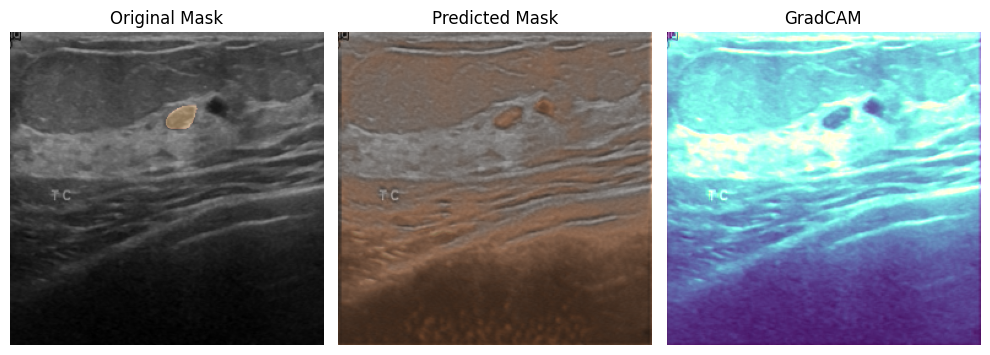

97/97 [==============================] - 325s 3s/step - loss: 0.2999 - accuracy: 0.9072 - IoU: 0.4548 - val_loss: 0.1771 - val_accuracy: 0.9813 - val_IoU: 0.4899
Epoch 8/20
 1/97 [..............................] - ETA: 5:38 - loss: 0.2717 - accuracy: 0.9155 - IoU: 0.4584

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd6fd50>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 4/97 [>.............................] - ETA: 3:19 - loss: 0.3412 - accuracy: 0.8811 - IoU: 0.4339  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf71c8b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 7/97 [=>............................] - ETA: 3:40 - loss: 0.3093 - accuracy: 0.9001 - IoU: 0.4444  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf71c8b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 8/97 [=>............................] - ETA: 3:25 - loss: 0.3262 - accuracy: 0.8936 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf71c8b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


12/97 [==>...........................] - ETA: 3:32 - loss: 0.3382 - accuracy: 0.8842 - IoU: 0.4388

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b279ef0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


14/97 [===>..........................] - ETA: 3:31 - loss: 0.3251 - accuracy: 0.8918 - IoU: 0.4411    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x1104c3f60>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


20/97 [=====>........................] - ETA: 3:23 - loss: 0.3032 - accuracy: 0.9035 - IoU: 0.4488

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf71c8b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


22/97 [=====>........................] - ETA: 3:14 - loss: 0.2972 - accuracy: 0.9060 - IoU: 0.4491    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b85a1b90>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


26/97 [=======>......................] - ETA: 3:01 - loss: 0.2926 - accuracy: 0.9079 - IoU: 0.4512

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd6e5a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


29/97 [=======>......................] - ETA: 2:50 - loss: 0.2950 - accuracy: 0.9072 - IoU: 0.4507  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b261090>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


34/97 [=========>....................] - ETA: 2:39 - loss: 0.2892 - accuracy: 0.9099 - IoU: 0.4521

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b25b3e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.2963 - accuracy: 0.9063 - IoU: 0.4528

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf772280>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


1/1 [==============================] - 0s 55ms/step


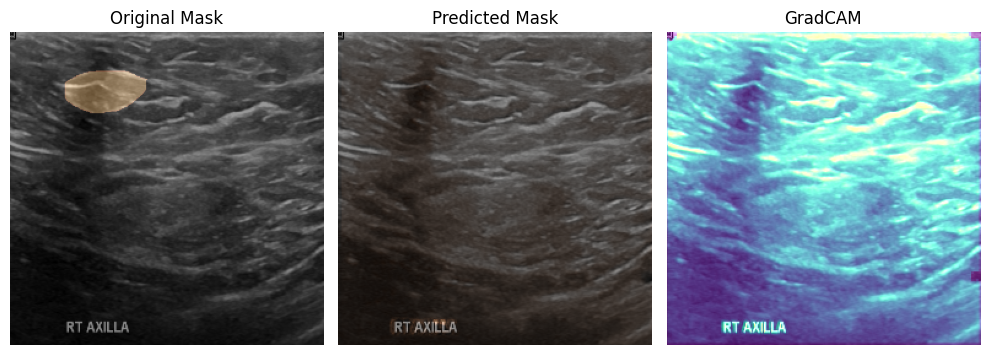

97/97 [==============================] - 360s 4s/step - loss: 0.2963 - accuracy: 0.9063 - IoU: 0.4528 - val_loss: 0.1543 - val_accuracy: 0.9812 - val_IoU: 0.4904
Epoch 9/20
 7/97 [=>............................] - ETA: 5:24 - loss: 0.2872 - accuracy: 0.9118 - IoU: 0.4570

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b2a2360>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


11/97 [==>...........................] - ETA: 4:30 - loss: 0.2799 - accuracy: 0.9129 - IoU: 0.4588

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd95d60>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


12/97 [==>...........................] - ETA: 4:10 - loss: 0.2876 - accuracy: 0.9094 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b825a9e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


13/97 [===>..........................] - ETA: 3:50 - loss: 0.2945 - accuracy: 0.9070 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd86940>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


14/97 [===>..........................] - ETA: 3:37 - loss: 0.2874 - accuracy: 0.9100 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b2998a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


16/97 [===>..........................] - ETA: 3:24 - loss: 0.2905 - accuracy: 0.9085 - IoU: 0.4578    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b2a11d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


17/97 [====>.........................] - ETA: 3:16 - loss: 0.2868 - accuracy: 0.9105 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd6f8d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


19/97 [====>.........................] - ETA: 3:08 - loss: 0.2899 - accuracy: 0.9086 - IoU: 0.4559    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b288800>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


26/97 [=======>......................] - ETA: 2:48 - loss: 0.2894 - accuracy: 0.9088 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf74da60>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b87879c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

27/97 [=======>......................] - ETA: 2:41 - loss: 0.2883 - accuracy: 0.9095 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b825a8c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


30/97 [========>.....................] - ETA: 2:36 - loss: 0.2966 - accuracy: 0.9057 - IoU: 0.4525  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b825c380>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


33/97 [=========>....................] - ETA: 2:30 - loss: 0.2939 - accuracy: 0.9065 - IoU: 0.4530  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b2b5d40>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


41/97 [===========>..................] - ETA: 2:19 - loss: 0.2922 - accuracy: 0.9067 - IoU: 0.4531

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf70b830>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


42/97 [===========>..................] - ETA: 2:16 - loss: 0.2931 - accuracy: 0.9064 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b288850>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


54/97 [===============>..............] - ETA: 1:51 - loss: 0.2884 - accuracy: 0.9087 - IoU: 0.4547

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd804a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


55/97 [================>.............] - ETA: 1:48 - loss: 0.2885 - accuracy: 0.9086 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2859ecd30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


77/97 [======================>.......] - ETA: 54s - loss: 0.2876 - accuracy: 0.9091 - IoU: 0.4550

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf73b7b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


86/97 [=========================>....] - ETA: 29s - loss: 0.2897 - accuracy: 0.9081 - IoU: 0.4547

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b8264fc0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


88/97 [==========================>...] - ETA: 24s - loss: 0.2905 - accuracy: 0.9078 - IoU: 0.4544    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b2bb2f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.2912 - accuracy: 0.9074 - IoU: 0.4545

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf73b650>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf75bad0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 43ms/step


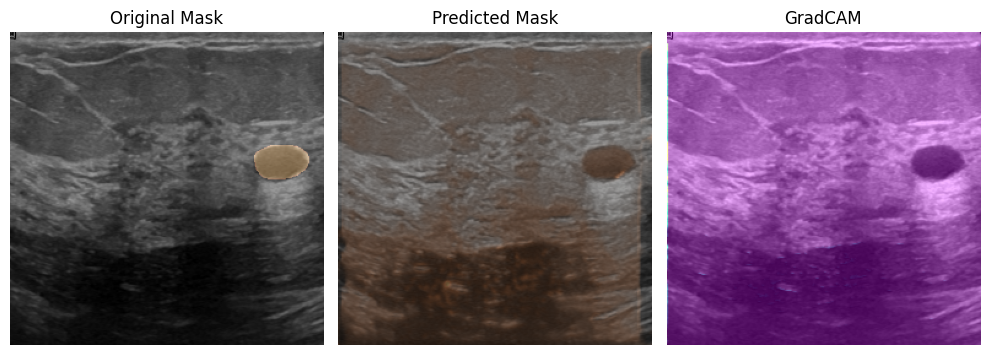

97/97 [==============================] - 306s 3s/step - loss: 0.2912 - accuracy: 0.9074 - IoU: 0.4545 - val_loss: 0.1394 - val_accuracy: 0.9813 - val_IoU: 0.4831
Epoch 10/20


Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf774980>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 6/97 [>.............................] - ETA: 4:10 - loss: 0.3234 - accuracy: 0.8886 - IoU: 0.4515

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bdc17a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


11/97 [==>...........................] - ETA: 4:07 - loss: 0.3026 - accuracy: 0.9006 - IoU: 0.4535

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b814bea0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


14/97 [===>..........................] - ETA: 3:55 - loss: 0.2958 - accuracy: 0.9032 - IoU: 0.4551  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bdcc390>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


17/97 [====>.........................] - ETA: 3:35 - loss: 0.2913 - accuracy: 0.9057 - IoU: 0.4563  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b2e55f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


27/97 [=======>......................] - ETA: 3:17 - loss: 0.2847 - accuracy: 0.9091 - IoU: 0.4574

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b2e64e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


28/97 [=======>......................] - ETA: 3:10 - loss: 0.2855 - accuracy: 0.9089 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bdc9f30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


79/97 [=======================>......] - ETA: 53s - loss: 0.2974 - accuracy: 0.9035 - IoU: 0.4527

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b24cad0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


81/97 [========================>.....] - ETA: 47s - loss: 0.2973 - accuracy: 0.9038 - IoU: 0.4529    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bdc1ee0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


83/97 [========================>.....] - ETA: 41s - loss: 0.2960 - accuracy: 0.9044 - IoU: 0.4528    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b2397d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


84/97 [========================>.....] - ETA: 38s - loss: 0.2952 - accuracy: 0.9048 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x4dd3521f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


88/97 [==========================>...] - ETA: 26s - loss: 0.2928 - accuracy: 0.9060 - IoU: 0.4536  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x4dd33a450>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


1/1 [==============================] - 0s 56ms/steploss: 0.2915 - accuracy: 0.9070 - IoU: 0.45


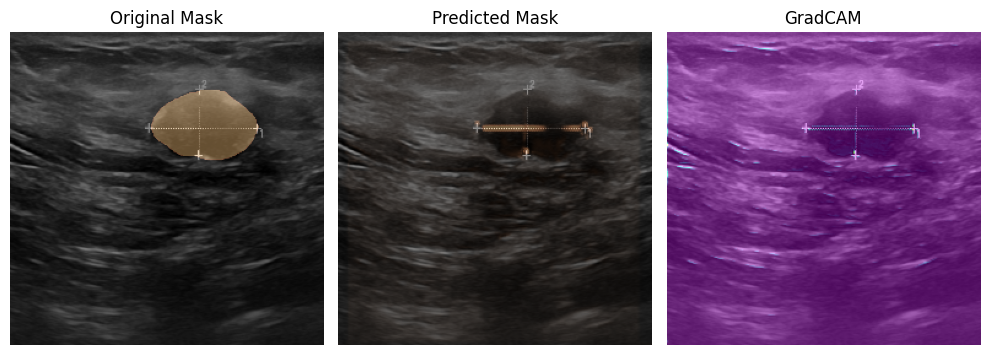

97/97 [==============================] - 337s 4s/step - loss: 0.2915 - accuracy: 0.9070 - IoU: 0.4540 - val_loss: 0.1145 - val_accuracy: 0.9812 - val_IoU: 0.4909
Epoch 11/20
 5/97 [>.............................] - ETA: 4:00 - loss: 0.2649 - accuracy: 0.9182 - IoU: 0.4598

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b814aba0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


20/97 [=====>........................] - ETA: 3:58 - loss: 0.2738 - accuracy: 0.9138 - IoU: 0.4572

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28b237b40>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


53/97 [===============>..............] - ETA: 3:43 - loss: 0.2866 - accuracy: 0.9085 - IoU: 0.4550

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28be20530>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


67/97 [===================>..........] - ETA: 2:20 - loss: 0.2816 - accuracy: 0.9109 - IoU: 0.4561

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28be26bc0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


70/97 [====================>.........] - ETA: 2:03 - loss: 0.2873 - accuracy: 0.9085 - IoU: 0.4545  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bdcdc60>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


74/97 [=====================>........] - ETA: 1:43 - loss: 0.2880 - accuracy: 0.9082 - IoU: 0.4544

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28be26a90>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


84/97 [========================>.....] - ETA: 55s - loss: 0.2875 - accuracy: 0.9081 - IoU: 0.4541 

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bdcc840>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


88/97 [==========================>...] - ETA: 37s - loss: 0.2873 - accuracy: 0.9082 - IoU: 0.4541  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bdde910>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


92/97 [===========================>..] - ETA: 20s - loss: 0.2871 - accuracy: 0.9083 - IoU: 0.4540  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2859309f0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


95/97 [============================>.] - ETA: 8s - loss: 0.2870 - accuracy: 0.9083 - IoU: 0.4539    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a69ac0e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


96/97 [============================>.] - ETA: 4s - loss: 0.2870 - accuracy: 0.9083 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3a69ac0e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.2863 - accuracy: 0.9087 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bde68e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3b825bdd0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 56ms/step


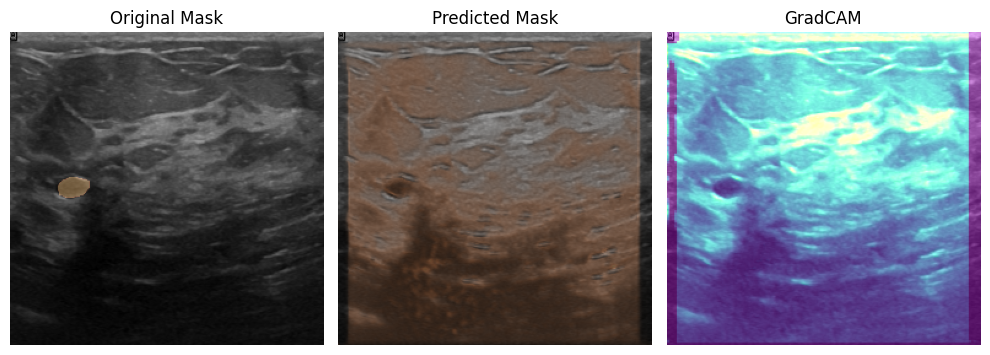

97/97 [==============================] - 426s 4s/step - loss: 0.2863 - accuracy: 0.9087 - IoU: 0.0000e+00 - val_loss: 0.1332 - val_accuracy: 0.9812 - val_IoU: 0.4936
Epoch 12/20


Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bde7c50>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


 2/97 [..............................] - ETA: 4:26 - loss: 0.2679 - accuracy: 0.9096 - IoU: 0.4595    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bdc48e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


26/97 [=======>......................] - ETA: 3:24 - loss: 0.2936 - accuracy: 0.9044 - IoU: 0.4533

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28be1d820>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


28/97 [=======>......................] - ETA: 3:15 - loss: 0.2970 - accuracy: 0.9026 - IoU: 0.4529    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28be40ae0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


30/97 [========>.....................] - ETA: 3:05 - loss: 0.2947 - accuracy: 0.9038 - IoU: 0.4534    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bde93c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


31/97 [========>.....................] - ETA: 3:01 - loss: 0.2958 - accuracy: 0.9033 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28be477a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


33/97 [=========>....................] - ETA: 2:51 - loss: 0.2966 - accuracy: 0.9032 - IoU: 0.4534    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28be1e460>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


34/97 [=========>....................] - ETA: 2:44 - loss: 0.2960 - accuracy: 0.9035 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x285890d90>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


40/97 [===========>..................] - ETA: 2:29 - loss: 0.2886 - accuracy: 0.9072 - IoU: 0.4559

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bdd85a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


41/97 [===========>..................] - ETA: 2:26 - loss: 0.2879 - accuracy: 0.9074 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2858a3870>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


43/97 [============>.................] - ETA: 2:21 - loss: 0.2896 - accuracy: 0.9069 - IoU: 0.4555    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bdea9a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


61/97 [=================>............] - ETA: 1:36 - loss: 0.2851 - accuracy: 0.9108 - IoU: 0.4572

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28be59340>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


62/97 [==================>...........] - ETA: 1:33 - loss: 0.2869 - accuracy: 0.9098 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28589f160>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


63/97 [==================>...........] - ETA: 1:30 - loss: 0.2868 - accuracy: 0.9098 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2858918e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


74/97 [=====================>........] - ETA: 1:01 - loss: 0.2832 - accuracy: 0.9115 - IoU: 0.4580

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2858ad3b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


77/97 [======================>.......] - ETA: 53s - loss: 0.2854 - accuracy: 0.9108 - IoU: 0.4574   

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bde4c50>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.2915 - accuracy: 0.9080 - IoU: 0.4556

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd56810>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2858b28b0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 53ms/step


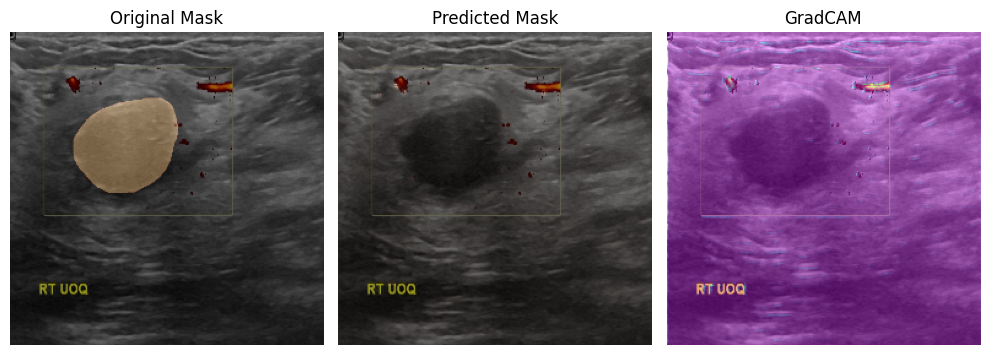

97/97 [==============================] - 319s 3s/step - loss: 0.2915 - accuracy: 0.9080 - IoU: 0.4556 - val_loss: 0.0983 - val_accuracy: 0.9813 - val_IoU: 0.4893
Epoch 13/20
23/97 [======>.......................] - ETA: 3:39 - loss: 0.3209 - accuracy: 0.8928 - IoU: 0.4473

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2858b72e0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


29/97 [=======>......................] - ETA: 3:16 - loss: 0.3180 - accuracy: 0.8946 - IoU: 0.4478

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bd592d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


48/97 [=============>................] - ETA: 2:22 - loss: 0.3025 - accuracy: 0.9025 - IoU: 0.4514

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2858bb0a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


1/1 [==============================] - 0s 57ms/steploss: 0.2906 - accuracy: 0.9076 - IoU: 0.45


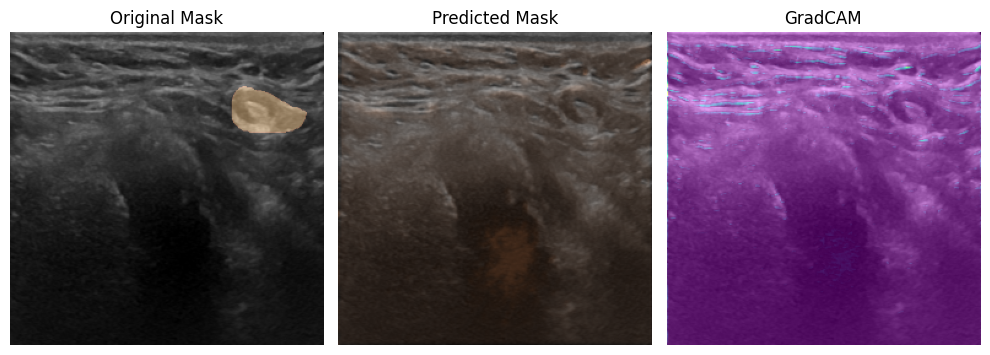

97/97 [==============================] - 355s 4s/step - loss: 0.2906 - accuracy: 0.9076 - IoU: 0.4544 - val_loss: 0.1099 - val_accuracy: 0.9812 - val_IoU: 0.4909
Epoch 14/20
47/97 [=============>................] - ETA: 2:36 - loss: 0.2952 - accuracy: 0.9067 - IoU: 0.4541

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28becb600>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


51/97 [==============>...............] - ETA: 2:22 - loss: 0.2977 - accuracy: 0.9054 - IoU: 0.4533

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28d712b20>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


60/97 [=================>............] - ETA: 1:52 - loss: 0.2935 - accuracy: 0.9072 - IoU: 0.4540

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bdcdb00>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


86/97 [=========================>....] - ETA: 34s - loss: 0.2844 - accuracy: 0.9106 - IoU: 0.4558

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2858e03a0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


1/1 [==============================] - 0s 57ms/steploss: 0.2858 - accuracy: 0.9099 - IoU: 0.45


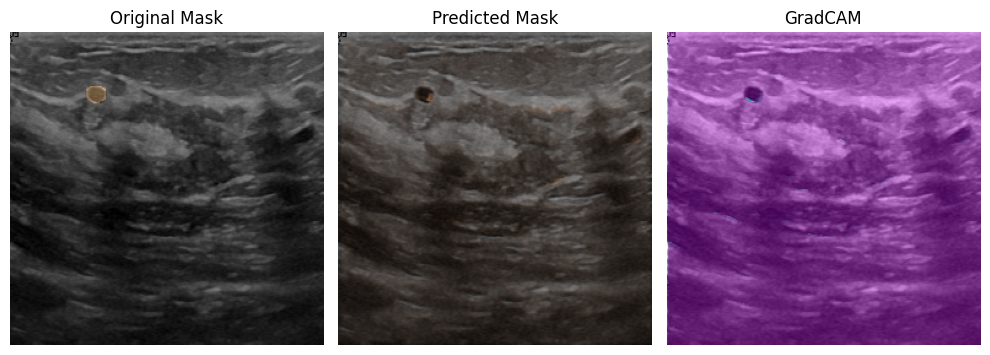

97/97 [==============================] - 366s 4s/step - loss: 0.2858 - accuracy: 0.9099 - IoU: 0.4553 - val_loss: 0.1225 - val_accuracy: 0.9812 - val_IoU: 0.4909
Epoch 15/20
12/97 [==>...........................] - ETA: 4:33 - loss: 0.2897 - accuracy: 0.9098 - IoU: 0.4558

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x2858f2040>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


46/97 [=============>................] - ETA: 2:39 - loss: 0.3044 - accuracy: 0.9016 - IoU: 0.4518

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bf08920>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


67/97 [===================>..........] - ETA: 1:35 - loss: 0.3046 - accuracy: 0.9011 - IoU: 0.4517

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28c7166d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


1/1 [==============================] - 0s 56ms/steploss: 0.3014 - accuracy: 0.9025 - IoU: 0.45


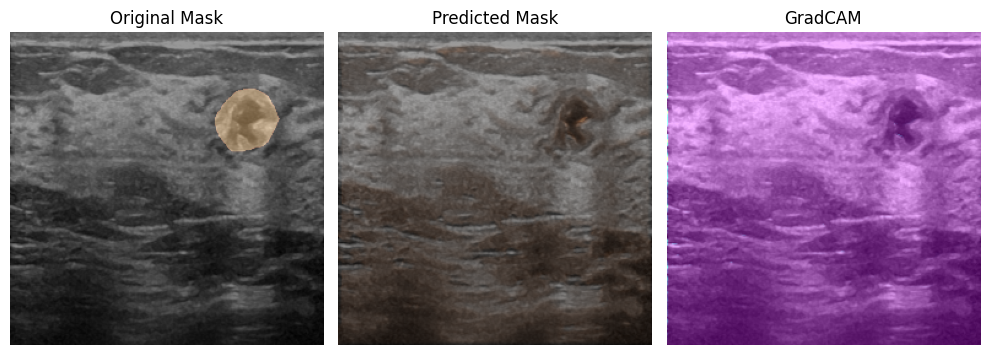

97/97 [==============================] - 375s 4s/step - loss: 0.3014 - accuracy: 0.9025 - IoU: 0.4523 - val_loss: 0.1308 - val_accuracy: 0.9812 - val_IoU: 0.4909
Epoch 16/20
50/97 [==============>...............] - ETA: 2:40 - loss: 0.2765 - accuracy: 0.9131 - IoU: 0.4574

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28c028a20>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


55/97 [================>.............] - ETA: 2:20 - loss: 0.2805 - accuracy: 0.9112 - IoU: 0.4564

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28bf1c860>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


57/97 [================>.............] - ETA: 2:11 - loss: 0.2778 - accuracy: 0.9127 - IoU: 0.4568    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28c7692d0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


72/97 [=====================>........] - ETA: 1:17 - loss: 0.2804 - accuracy: 0.9110 - IoU: 0.4561

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28c76ab20>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


77/97 [======================>.......] - ETA: 1:01 - loss: 0.2814 - accuracy: 0.9109 - IoU: 0.4560

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28d75d400>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


78/97 [=======================>......] - ETA: 57s - loss: 0.2814 - accuracy: 0.9111 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf85bb30>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


80/97 [=======================>......] - ETA: 51s - loss: 0.2820 - accuracy: 0.9109 - IoU: 0.4559    

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28c0484c0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


84/97 [========================>.....] - ETA: 39s - loss: 0.2812 - accuracy: 0.9112 - IoU: 0.4564  

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf868950>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


89/97 [==========================>...] - ETA: 23s - loss: 0.2843 - accuracy: 0.9097 - IoU: 0.4554

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28d758e90>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


90/97 [==========================>...] - ETA: 20s - loss: 0.2843 - accuracy: 0.9097 - IoU: 0.0000e+00

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf855bf0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


97/97 [==============================] - ETA: 0s - loss: 0.2840 - accuracy: 0.9099 - IoU: 0.4559

Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28d75c870>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1
Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x28c789db0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    r

1/1 [==============================] - 0s 49ms/step


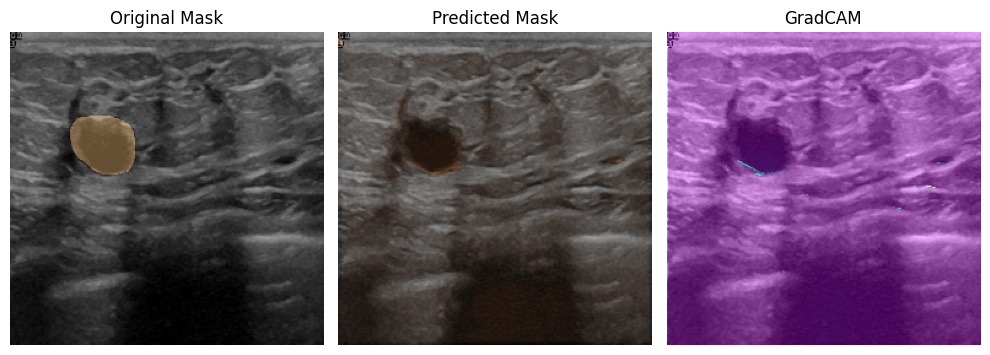

97/97 [==============================] - 337s 3s/step - loss: 0.2840 - accuracy: 0.9099 - IoU: 0.4559 - val_loss: 0.1463 - val_accuracy: 0.9811 - val_IoU: 0.4893
Epoch 17/20
 8/97 [=>............................] - ETA: 5:01 - loss: 0.2801 - accuracy: 0.9100 - IoU: 0.4560WARNING:tensorflow:Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches (in this case, 1940 batches). You may need to use the repeat() function when building your dataset.


Error: command buffer exited with error status.
	The Metal Performance Shaders operations encoded on it may not have completed.
	Error: 
	(null)
	Internal Error (0000000e:Internal Error)
	<AGXG13XFamilyCommandBuffer: 0x3bf883cf0>
    label = <none> 
    device = <AGXG13XDevice: 0x163441e00>
        name = Apple M1 Pro 
    commandQueue = <AGXG13XFamilyCommandQueue: 0x125008800>
        label = <none> 
        device = <AGXG13XDevice: 0x163441e00>
            name = Apple M1 Pro 
    retainedReferences = 1


1/1 [==============================] - 0s 48ms/step


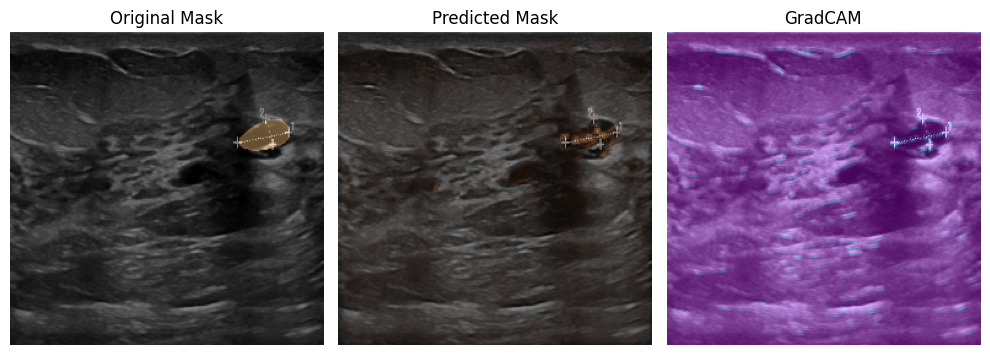

97/97 [==============================] - 90s 902ms/step - loss: 0.2801 - accuracy: 0.9100 - IoU: 0.4560 - val_loss: 0.1267 - val_accuracy: 0.9811 - val_IoU: 0.4904


In [28]:
BATCH_SIZE = 8
SPE = len(images)//BATCH_SIZE

# Training
results = model.fit(
    images, masks,
    validation_split=0.2,
    epochs=20, 
    steps_per_epoch=SPE,
    batch_size=BATCH_SIZE,
    callbacks=cb
)

Observations :

After 12 epochs model started outputting what we needed.
The model was easily able to detect black round spots but fails when the shape is irregular(Not the case with current model because it is trained with hight SPE).

It also gets confused between the dark areas, which makes sense.

# Evaluation

In [29]:
loss, accuracy, iou, val_loss, val_accuracy, val_iou = results.history.values()

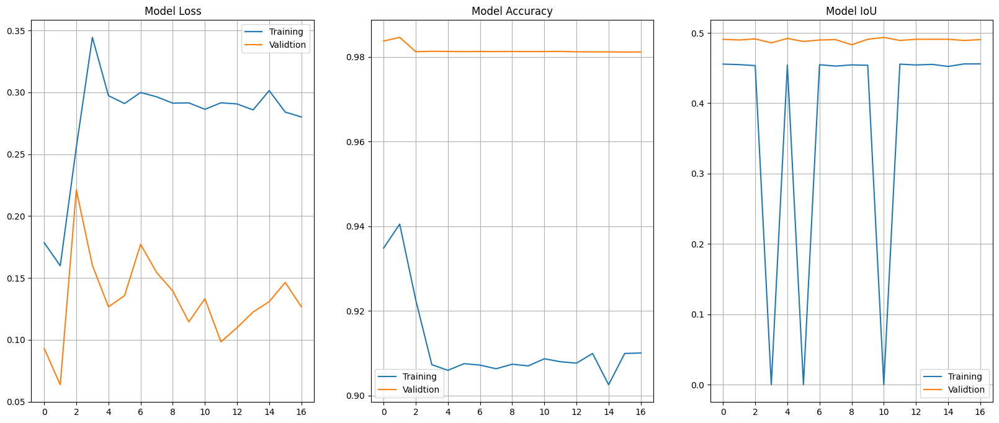

In [30]:
plt.figure(figsize=(20,8))

plt.subplot(1,3,1)
plt.title("Model Loss")
plt.plot(loss, label="Training")
plt.plot(val_loss, label="Validtion")
plt.legend()
plt.grid()

plt.subplot(1,3,2)
plt.title("Model Accuracy")
plt.plot(accuracy, label="Training")
plt.plot(val_accuracy, label="Validtion")
plt.legend()
plt.grid()

plt.subplot(1,3,3)
plt.title("Model IoU")
plt.plot(iou, label="Training")
plt.plot(val_iou, label="Validtion")
plt.legend()
plt.grid()

plt.show()

The results on Validation Data are way better than the results on Trainind Data on IoU, this may indicate that the model can perform way better than what it can do at the current point. The Loss is not Perfect it increases in the last. 

# Trying it on Pictures

1/1 [==============================] - 0s 38ms/step


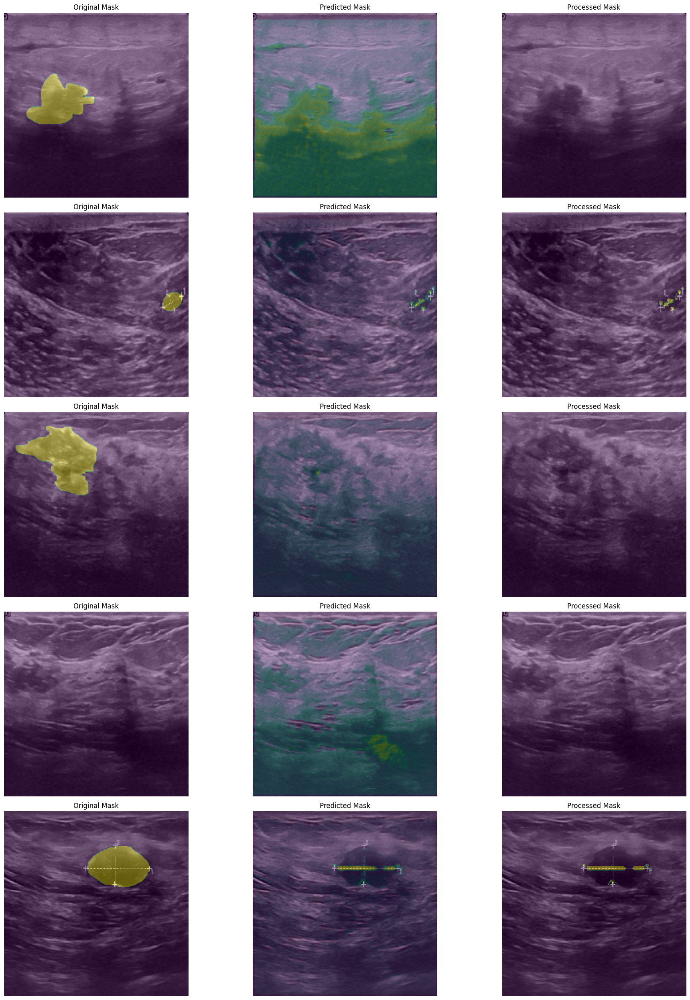

In [31]:
plt.figure(figsize=(20,25))
n=0
for i in range(1,(5*3)+1):
    plt.subplot(5,3,i)
    if n==0:
        id = np.random.randint(len(images))
        image = images[id]
        mask = masks[id]
        pred_mask = model.predict(image[np.newaxis,...])

        plt.title("Original Mask")
        show_mask(image, mask)
        n+=1
    elif n==1:
        plt.title("Predicted Mask")
        show_mask(image, pred_mask)
        n+=1
    elif n==2:
        pred_mask = (pred_mask>0.5).astype('float')
        plt.title("Processed Mask")
        show_mask(image, pred_mask)
        n=0
plt.tight_layout()
plt.show()